# Power data classification

### Análisis frecuencial del time-series de ENERPI Power (W):

- Recuperación de todos los datos recopilados por el data-logger ENERPI
- Resampling a '1s' para homogeneizar la ts, filling de NaN's con valor clave = -1

In [553]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
%load_ext memory_profiler
from IPython.display import Image, HTML

import datetime as dt
from hdbscan import HDBSCAN
from itertools import cycle
import math
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mpd
from mpl_toolkits.mplot3d import Axes3D
import numexpr as ne
import numpy as np
import pandas as pd
import pysolar
import pytz
import random
import scipy
from scipy.signal import medfilt, wiener
import scipy.signal as signal
import seaborn as sns
import sklearn
import sklearn.metrics as metrics
from sklearn.cluster import KMeans, DBSCAN, AffinityPropagation, AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

from enerpi.base import timeit
from enerpi.api import enerpi_data_catalog
from enerpi.process_ldr import pca_clustering, plot_clustering, plot_clustering_as_voronoi, plot_clustering_figure, tableau20
#from enerpi.enerplot import plot_tile_last_24h, plot_power_consumption_hourly
from enerpi.sunposition import sun_position
from prettyprinting import *


# Catálogo y lectura de todos los datos.
@timeit('LOAD ALL DATA', verbose=True)
def load_data():
    cat = enerpi_data_catalog()
    data, data_s = cat.get_all_data()
    print_info(data_s.tail())

    POWER = pd.DataFrame(data.power).tz_localize(TZ)
    print_cyan(POWER.describe().T.astype(int))

    homog_power = POWER.resample('1s').mean().fillna(method='bfill', limit=3).fillna(-1) #.round().astype('int16')
    return data, data_s, POWER, homog_power


TZ = pytz.timezone('Europe/Madrid')
FS = (16, 10)
sns.set_style('ticks')
pd.set_option('display.width', 120)
cm = cycle(tableau20[2::2])

data, data_s, POWER, homog_power = load_data()

# Some Sampling:
power_day13 = homog_power.loc['2016-08-13']
power_day14 = homog_power.loc['2016-08-14']
power_standby = homog_power.loc['2016-08-29']

***TIMEIT get_all_data TOOK: 2.126 s
                          kWh     t_ref  n_jump  n_exec   p_max  p_mean  p_min
ts                                                                            
2016-10-01 08:00:00  0.241613  0.999984       0       0   296.0   242.0  213.0
2016-10-01 09:00:00  0.239351  0.999929       0       0   809.0   239.0  213.0
2016-10-01 10:00:00  0.279239  0.999890       0       0  2482.0   279.0  208.0
2016-10-01 11:00:00  0.406760  1.000036       0       0  2164.0   407.0  211.0
2016-10-01 12:00:00  0.763307  0.687710       0       0  2532.0  1110.0  331.0
         count  mean  std  min  25%  50%  75%   max
power  4182498   348  321  112  225  267  361  5304
LOAD ALL DATA TOOK: 3.846 s


## Funciones de cálculo y plotting de FFT

También funciones de plotting clusters y de generación de ts mediante sinusoides

In [191]:
def process_fft(serie_tt, with_freq=True):
    # Scipy Real FFT
    z_pure = scipy.fftpack.rfft(serie_tt - serie_tt.mean()) / len(serie_tt)
    if z_pure.shape[0] % 2 == 0:  # N es par
        mags = np.concatenate([[abs(z_pure[0])], np.sqrt(z_pure[1:-1:2]**2 + z_pure[2::2]**2), [abs(z_pure[-1])]])
    else:
        mags = np.concatenate([[abs(z_pure[0])], np.sqrt(z_pure[1::2]**2 + z_pure[2::2]**2)])
    if with_freq:
        y = scipy.fftpack.rfftfreq(len(serie_tt), d=(serie_tt.index[1] - serie_tt.index[0]).total_seconds())
        freqs = np.concatenate((np.zeros(1), y[1::2]))
        return freqs, mags
    return mags


@timeit('slice_window_fft', verbose=True)
def _slice_window_fft(serie_tt, size_w, frac_solape=.5, only_complete=True):
    # %timeit _slice_window_fft(power_standby, 14400, frac_solape=.75)
    # 100 loops, best of 3: 10.4 ms per loop

    N = len(serie_tt)
    start = serie_tt.index[0]
    end = serie_tt.index[-1]
    T = end - start
    Ts = serie_tt.index[1] - start
    delta = pd.Timedelta(seconds=int(round(((1 - frac_solape) * size_w * Ts).total_seconds())))
    # print(delta, (1 - frac_solape) * size_w * Ts)
    n = (T - size_w * Ts) / delta + 1
    results, freqs, init = [], None, False
    while start < end:
        data_w = serie_tt.loc[start:start + size_w * Ts - Ts]
        if only_complete and (data_w.shape[0] == size_w):
            if not init:
                freqs, mags = process_fft(data_w, with_freq=True)
                init = True
            else:
                mags = process_fft(data_w, with_freq=False)
            results.append((start, mags))
        #else:
        #    print('No se procesa ts={} (shape={} != {})'.format(start, data_w.shape, size_w))
        start += delta
    return freqs, results

    
@timeit('fft_window', verbose=True)
def fft_window(serie_tt, delta='3h', step='15min'):
    window_delta = pd.Timedelta(delta)
    window_step = pd.Timedelta(step)
    fr_s = 1 - window_step / window_delta
    window_size = window_delta / serie_tt.index.freq
    print_cyan('Data lenght: {}; window size: {:.0f}, step: {}, (solape={:.3f})'
               .format(len(serie_tt), window_size, window_step, fr_s))
    freqs, results = _slice_window_fft(serie_tt, window_size, fr_s)
    return pd.DataFrame([pd.Series(data=r[1], index=freqs, name=r[0]) for r in results]).T


@timeit('plot_tt_fft', verbose=True)
def plot_tt_fft(serie_tt, 
                freqs=None, mags=None, 
                max_freq=.1, best_freqs=5,
                axes=None, figsize=(8, 8), 
                params_plot_fft={}, params_plot_t={}, **params_window_fft):
    # PLOT tt + fft
    if axes is None:
        fig, axes = plt.subplots(2, 1, figsize=figsize, 
                                 gridspec_kw=dict(hspace=0, wspace=0, height_ratios=[.45, .55]))
    ax = axes[0]
    ax.xaxis.tick_top()
    d_plot_t = dict(c=tableau20[4], lw=1, alpha=.8)
    d_plot_t.update(params_plot_t)
    serie_tt.tz_localize(None).plot(ax=ax, **d_plot_t)
    #ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M:%S'))
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, ha='center')
    ax.xaxis.set_tick_params(labelsize=8, pad=2)
    ax.set_ylabel('(Power) time series', labelpad=3)
    ax.grid('on', axis='x')
    ax.set_yticks(ax.get_yticks()[1:])

    # FFT plot
    ax = axes[1]
    ax.xaxis.tick_bottom()
    if (mags is None) and len(params_window_fft) > 0:
        df_fft_w = fft_window(serie_tt, **params_window_fft)
        d_plot = dict(lw=.75, c='k', alpha=max(.05, 1/len(df_fft_w.columns)))
        d_plot.update(params_plot_fft)
        df_fft_w.plot(ax=ax, legend='', **d_plot)
        df_fft_w.median(axis=1).plot(ax=ax, lw=.75, c=tableau20[2], alpha=.8)
        ax.set_xlim((0, min(max_freq, df_fft_w.max(axis=1).sort_values(ascending=False).index[0] * 10)))
    else:
        if mags is None:
            freqs, mags = process_fft(serie_tt, with_freq=True)
        d_plot = dict(c=tableau20[0], lw=1.25, alpha=.8)
        d_plot.update(params_plot_fft)
        ax.plot(freqs, mags, **d_plot)
        if best_freqs > 0:
            idx_max = np.argsort(mags)[-best_freqs:][::-1]
            mag_max = mags.max()
            for i, (f, mag) in enumerate(zip(freqs[idx_max], mags[idx_max])):
                fr = mag / mag_max
                ax.plot([f], [mag], 'o', markersize=10, markeredgewidth=1.5, markeredgecolor=tableau20[2], markerfacecolor=[0, 0, 0, 0])
                ax.annotate('f=1/{:.1f}, A={:.2g}'.format(1 / f, mag / mag_max), (f, mag),
                            xytext=(.97, .92 - i * .075), textcoords='axes fraction', 
                            ha='right', va='bottom', fontsize=8, color=tableau20[2], 
                            arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=-0.05"))
        ax.set_xlim((0, min(max_freq, freqs[np.argmax(mags)] * 10)))
    ax.set_xlabel('Freq (Hz)', labelpad=1)
    ax.set_ylabel('Mag (√|mag|)', labelpad=3)
    #ax.set_xlim((2/N, (1/Ts)/2))
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, ha='center')
    ax.xaxis.set_tick_params(labelsize=9, pad=3)
    #ax.set_yticks(ax.get_yticks()[:-1])
    return axes


def _gen_ts_sinusoidal(Ts=1, tf=3600, 
                       freqs=[1 / 300, 1 / 225, 1 / 60, 1/20], 
                       amps=[3, 7, 2, .5],
                       offsets=[3, 7, -5, .15], 
                       mean=30):
    N = tf // Ts
    tt = pd.DatetimeIndex(freq=pd.Timedelta(seconds=Ts), start=pd.Timestamp.now(tz=TZ).replace(microsecond=0), 
                          periods=N)
    t = np.linspace(0, tf, N)
    x = mean #+ np.random.random(N) * 0.3
    for a, f, o in zip(amps, freqs, offsets):
        x += a * np.cos(2*np.pi*f*t + o)
    return tt, x


def _show_info_clustering(X, labels, labels_true=None, with_sihouette_coef=False):
    n_clusters_ = len(set(labels))
    print_magenta('Estimated number of clusters: %d' % n_clusters_)
    if labels_true is not None:
        print_ok("Homogeneity: %0.3f" % metrics.homogeneity_score(labels_true, labels))
        print_ok("Completeness: %0.3f" % metrics.completeness_score(labels_true, labels))
        print_ok("V-measure: %0.3f" % metrics.v_measure_score(labels_true, labels))
        print_ok("Adjusted Rand Index: %0.3f" % metrics.adjusted_rand_score(labels_true, labels))
        print_ok("Adjusted Mutual Information: %0.3f" % metrics.adjusted_mutual_info_score(labels_true, labels))
    if with_sihouette_coef:
        print_info("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(X, labels, metric='sqeuclidean'))
    print_cyan(pd.DataFrame(pd.Series(labels).value_counts().rename('Label members')).T)


def _plot_reduced_clustering(X, labels=None, axes3d=False, figsize=(18, 5), s_resid=1, cm=None, **kwargs_plot):
    d_params = dict(alpha=.1, lw=0, s=7)
    d_params.update(kwargs_plot)
    if cm is None:
        #cm = cycle(tableau20[::2] + tableau20[1::2])
        cm = cycle(tableau20[::2])
    if labels is not None:
        labels_unique = set(labels)
        groups = [X[labels == k] for k in labels_unique]
        colors = [next(cm) if k >= 0 else 'k' for k in labels_unique]
        s = d_params.pop('s')
        sizes = [s if k >= 0 else s_resid for k in labels_unique]
    else:
        groups = [X]
        colors = ['k']
        sizes = [d_params.pop('s')]
    fig = plt.figure(figsize=(18, 5))
    
    if X.shape[1] > 2:
        if axes3d:
            ax = fig.add_subplot(111, projection='3d')
            for x, c, s in zip(groups, colors, sizes):
                d_params['color'] = c
                ax.scatter(x[:,0], x[:,1], x[:,2], s=s, **d_params)
        else:
            ax1 = plt.subplot(131)
            ax2 = plt.subplot(132)
            ax3 = plt.subplot(133)
            for x, c, s in zip(groups, colors, sizes):
                d_params['color'] = c
                ax1.scatter(x[:,0], x[:,1], s=s, **d_params)
                ax2.scatter(x[:,0], x[:,2], s=s, **d_params)
                ax3.scatter(x[:,1], x[:,2], s=s, **d_params)
    else:
        ax = fig.add_subplot(111)
        for x, c, s in zip(groups, colors, sizes):
            d_params['color'] = c
            ax.scatter(x[:,0], x[:,1], s=s, **d_params)

### Resultados de windowed-FFT

Para días sueltos y para el conjunto total, con diferentes ∆W y ∆T:

In [3]:
df_results = fft_window(power_standby.power, delta='3h', step='10min')
df_results_2 = fft_window(power_day14.power, delta='3h', step='10min')

# Resultados de all data:
results_FFT = fft_window(homog_power.power, delta='10min', step='5min')
print_ok(results_FFT.shape)

Data lenght: 86400; window size: 10800, step: 0 days 00:10:00, (solape=0.944)
slice_window_fft TOOK: 0.109 s
fft_window TOOK: 0.245 s
Data lenght: 86400; window size: 10800, step: 0 days 00:10:00, (solape=0.944)
slice_window_fft TOOK: 0.103 s
fft_window TOOK: 0.233 s
Data lenght: 3726199; window size: 600, step: 0 days 00:05:00, (solape=0.500)
slice_window_fft TOOK: 5.276 s
fft_window TOOK: 7.632 s
(301, 12419)


In [4]:
X = results_FFT.T.values
X_std = StandardScaler().fit_transform(X)

m_pca = PCA(n_components=2, copy=True, whiten=True)
#X_pca = m_pca.fit_transform(X_std)
X_pca = m_pca.fit_transform(X)

m_pca3 = PCA(n_components=3, copy=True, whiten=True)
#X_pca3 = m_pca3.fit_transform(X_std)
X_pca3 = m_pca3.fit_transform(X)

m_pca20 = PCA(n_components=20, copy=True, whiten=True)
#X_pca20 = m_pca20.fit_transform(X_std)
X_pca20 = m_pca20.fit_transform(X)

print(X.shape, X_std.shape, X_pca.shape, X_pca3.shape, X_pca20.shape)

(12419, 301) (12419, 301) (12419, 2) (12419, 3) (12419, 20)


plot_tt_fft TOOK: 1.103 s
plot_tt_fft TOOK: 0.937 s


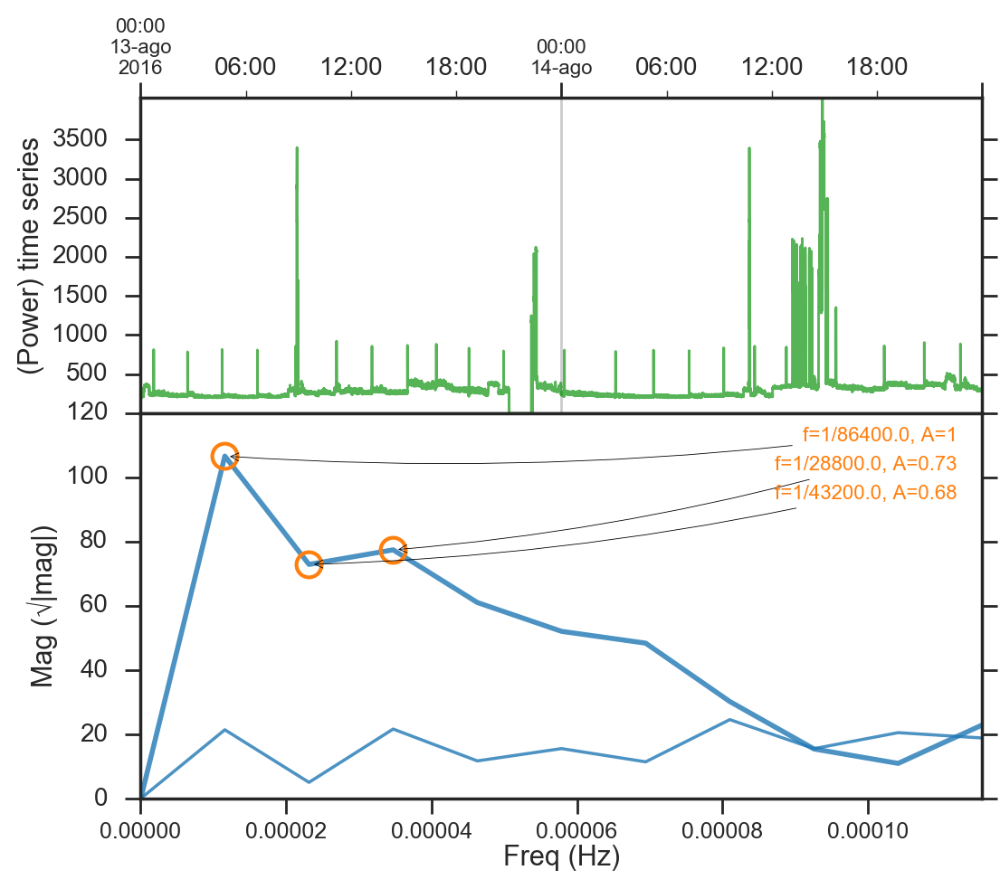

In [85]:
axes = plot_tt_fft(power_day13.power, freqs=None, mags=None, max_freq=.1, best_freqs=0, figsize=(6, 5))
#axes = plot_tt_fft(power_day14.power, freqs=None, mags=None, max_freq=.1, best_freqs=5, axes=axes, delta='10min', step='5min')

freqs, mags = process_fft(power_day14.power)
axes = plot_tt_fft(power_day14.power, freqs, mags, max_freq=.1, best_freqs=3, axes=axes, params_plot_fft=dict(lw=2))


#axes=None, figsize=(8, 8), **params_window_fft

Data lenght: 86400; window size: 3600, step: 0 days 00:10:00, (solape=0.833)
slice_window_fft TOOK: 0.061 s
fft_window TOOK: 0.132 s
plot_tt_fft TOOK: 1.706 s


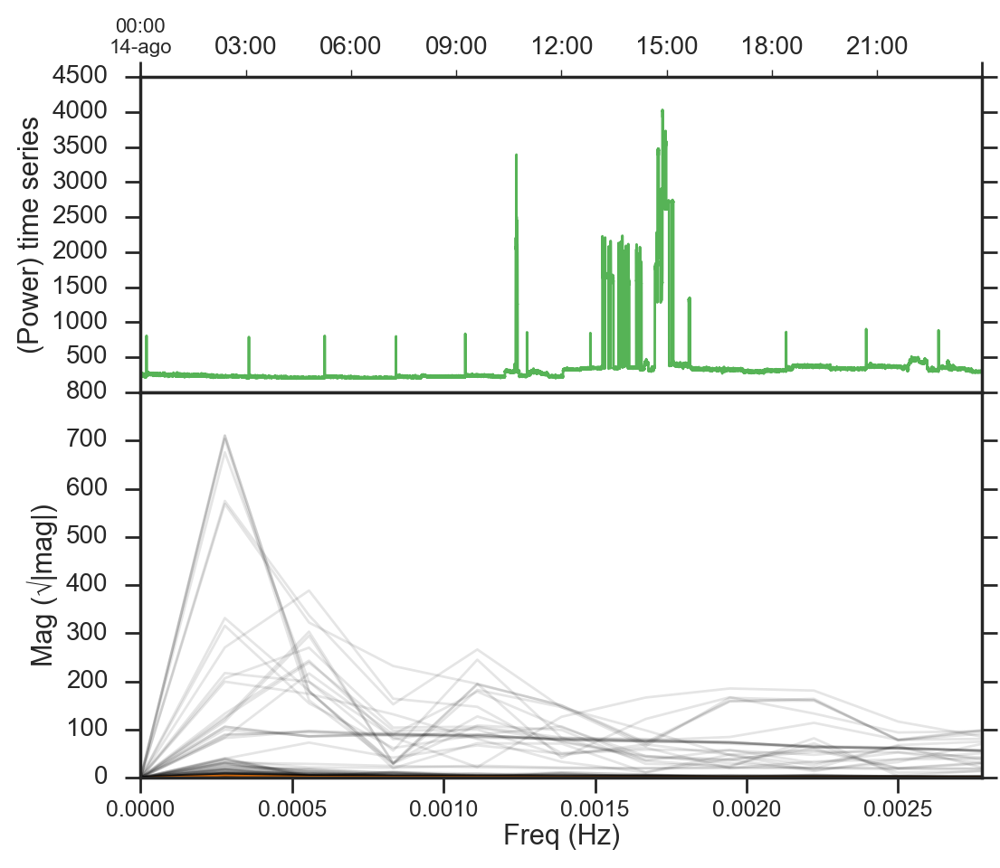

In [86]:
ax_t, ax_f = plot_tt_fft(power_day14.power, max_freq=.1, best_freqs=3, figsize=(6, 5), 
                         delta='1h', step='10min', params_plot_fft=dict(lw=1, alpha=.1, c='k'))
#ax_f.set_ylim(0, 800)
plt.show()

### Subconjunto continuo para entrenamiento:

De '2016-09-08' a '2016-09-21' (2 semanas completas)

* Head:
                                power
ts                                   
2016-09-08 00:00:00+02:00  361.305145
2016-09-08 00:00:01+02:00  369.346436
2016-09-08 00:00:02+02:00  366.049744
* Tail:
                                power
ts                                   
2016-09-21 23:59:57+02:00  303.040344
2016-09-21 23:59:58+02:00  301.786438
2016-09-21 23:59:59+02:00  294.609619
* Describe:
           count        mean         std         min         25%        50%         75%          max
power  1209600.0  361.121826  349.925092  164.215744  230.761772  289.34404  359.412018  4377.393066
Valores nulos:
Empty DataFrame
Columns: [power]
Index: []
plot_tt_fft TOOK: 15.403 s
Data lenght: 1209600; window size: 600, step: 0 days 00:02:00, (solape=0.800)
slice_window_fft TOOK: 4.289 s
fft_window TOOK: 8.939 s
plot_tt_fft TOOK: 111.678 s


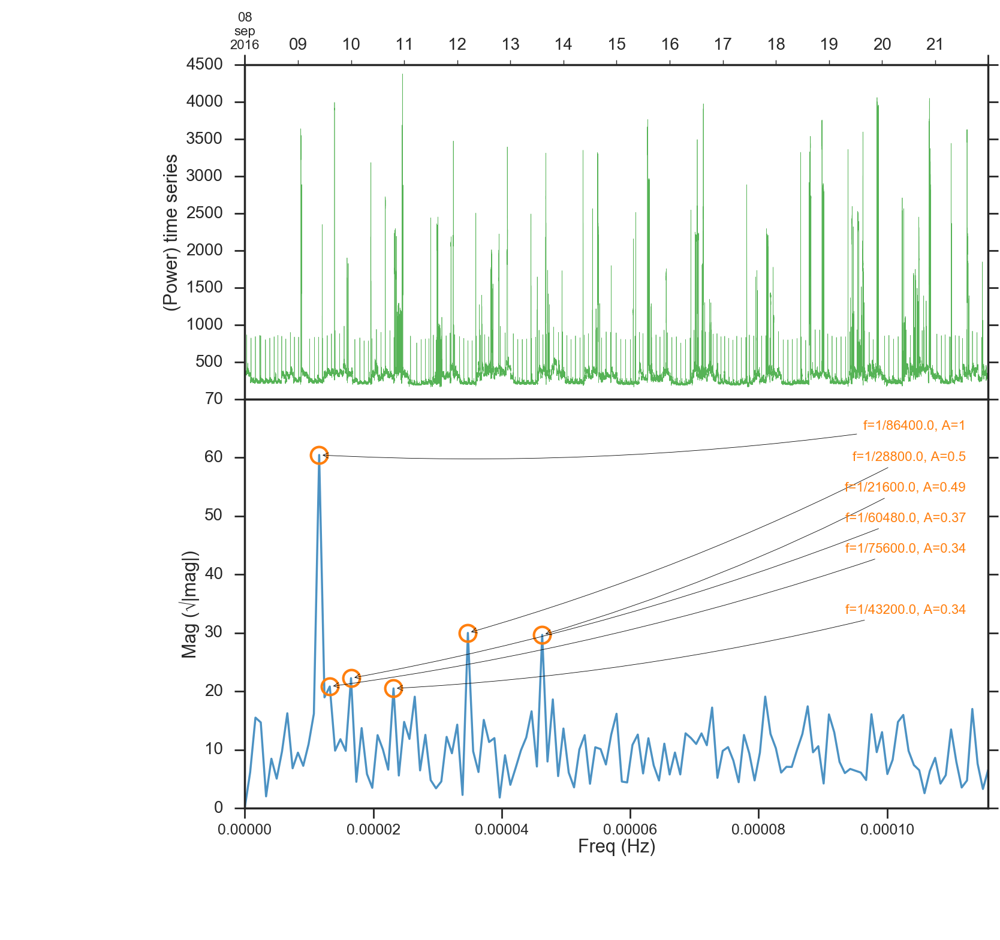

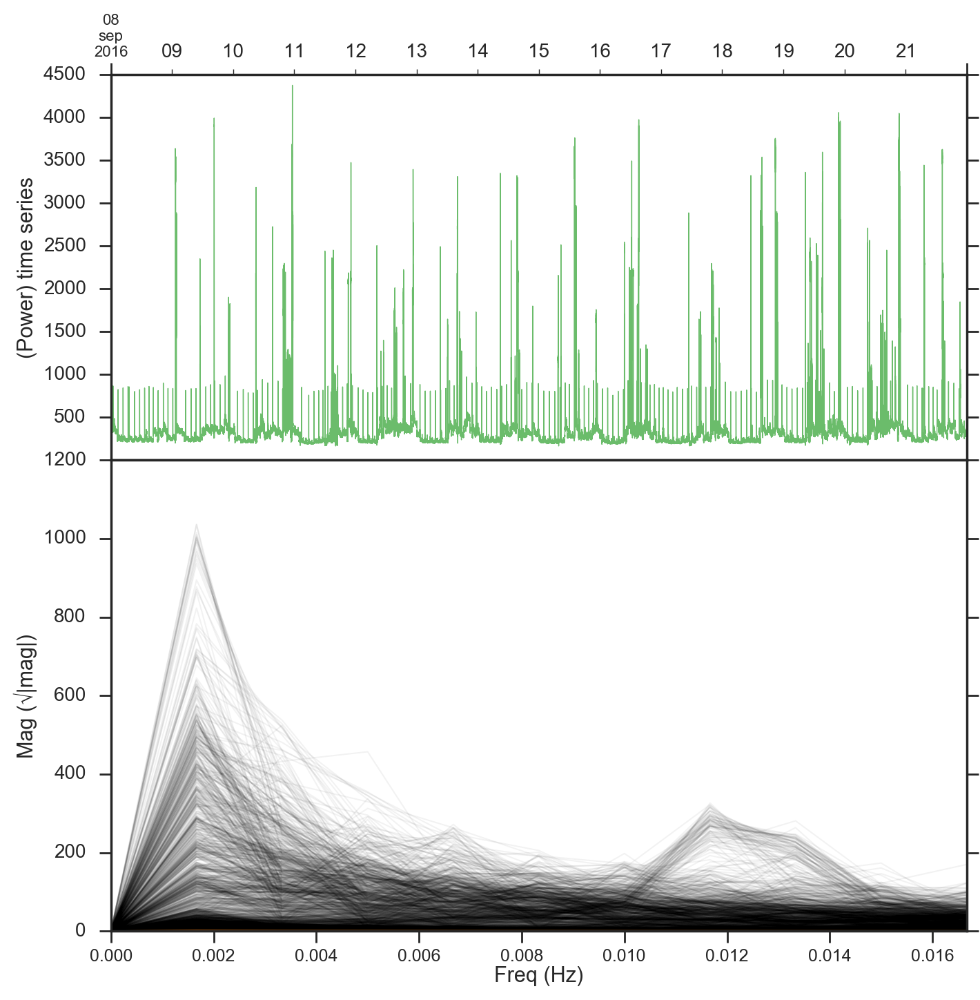

In [1135]:
train = homog_power.loc['2016-09-08':'2016-09-21'].copy()
print_info('* Head:\n{}\n* Tail:\n{}\n* Describe:\n{}\nValores nulos:\n{}'
           .format(train.head(3), train.tail(3), train.describe().T, 
                   train[train.power==-1].groupby(lambda x: x.date).count()))

# Plot tt + fft:
plot_tt_fft(train.power, max_freq=.1, best_freqs=7, params_plot_t=dict(lw=.25, alpha=.8))
plot_tt_fft(train.power, max_freq=.1, params_plot_t=dict(lw=.5, alpha=.7), delta='10min', step='2min');

Data lenght: 1209600; window size: 86400, step: 1 days 00:00:00, (solape=0.000)
slice_window_fft TOOK: 0.037 s
fft_window TOOK: 0.575 s
(43201, 14)
          2016-09-08 00:00:00+02:00  2016-09-09 00:00:00+02:00  2016-09-10 00:00:00+02:00  2016-09-11 00:00:00+02:00  \
0.000000                   0.000397                   0.001090                   0.000530                   0.000548   
0.000012                  21.698128                  50.041778                 112.034100                  76.473141   
0.000023                   3.655552                  43.123575                  95.187303                  20.061025   
0.000035                   7.170931                  30.968047                  53.467609                  59.012669   
0.000046                   8.925584                  24.901947                  46.409556                  53.889442   

          2016-09-12 00:00:00+02:00  2016-09-13 00:00:00+02:00  2016-09-14 00:00:00+02:00  2016-09-15 00:00:00+02:00  \
0.000000   

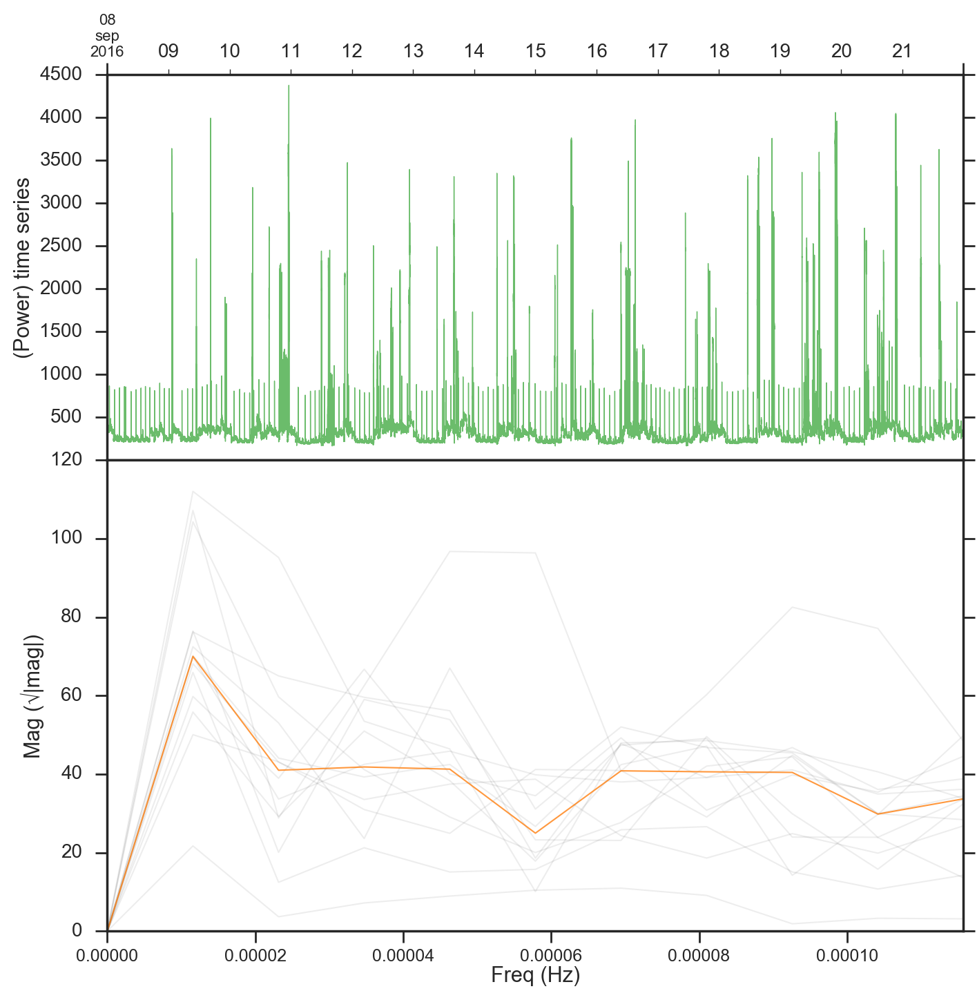

In [124]:
df_fft_train_daily = fft_window(train.power, delta='24h', step='24h')
print_info(df_fft_train_daily.shape)
print_info(df_fft_train_daily.head())
plot_tt_fft(train.power, max_freq=.1, params_plot_t=dict(lw=.5, alpha=.7), delta='24h', step='24h');

In [171]:
# FFT 'features' por delta, cada step:
delta, step = '10min', '2min'
df_fft_train = fft_window(train.power, delta=delta, step=step)
print_info(df_fft_train.shape)


# Extracción de 'features' por delta, cada step
n_delta = int(pd.Timedelta(delta).total_seconds())
n_step = int(pd.Timedelta(step).total_seconds())

roll = train.power.rolling(n_delta)
df_tt_train = pd.DataFrame([roll.mean().shift(-(n_delta - 1)).iloc[::n_step].dropna().rename('r_mean'), 
                            roll.median().shift(-(n_delta - 1)).iloc[::n_step].dropna().rename('r_median'), 
                            roll.max().shift(-(n_delta - 1)).iloc[::n_step].dropna().rename('r_max'), 
                            roll.min().shift(-(n_delta - 1)).iloc[::n_step].dropna().rename('r_min'), 
                            roll.std().shift(-(n_delta - 1)).iloc[::n_step].dropna().rename('r_std')])

#df_tt_train.T.values
#df_tt_train.T.plot(lw=.75, alpha=.7)
df_train = df_tt_train.T.join(df_fft_train.T).T
df_train.head(10).T.head(3)

Data lenght: 1209600; window size: 600, step: 0 days 00:02:00, (solape=0.800)
slice_window_fft TOOK: 4.087 s
fft_window TOOK: 7.570 s
(301, 10076)


,r_mean,r_median,r_max,r_min,r_std,0.0,0.0016666666666666668,0.0033333333333333335,0.005,0.006666666666666667
ts,,,,,,,,,,
2016-09-07 22:00:00+00:00,351.305543,352.215378,407.058716,283.988556,20.645514,0.000121,1.087532,0.520027,2.056384,2.460438
2016-09-07 22:02:00+00:00,351.506563,351.863419,407.058716,283.988556,19.238940,0.000090,0.992121,0.812721,1.615344,2.787228
2016-09-07 22:04:00+00:00,350.797838,350.857880,400.749542,285.457306,14.549966,0.000078,0.506782,1.890101,1.100943,1.734993


In [172]:
X = df_train.T.values
m_ag15 = AgglomerativeClustering(n_clusters=15, linkage='average', affinity='manhattan')
m_ag15.fit(X)

labels_ag15 = pd.Series(m_ag15.labels_, name='k_ag', index=df_train.T.index)
pd.DataFrame(labels_ag15.value_counts()).T

,7,12,10,0,2,4,5,3,1,11,9,13,14,6,8
k_ag,9465,288,92,77,50,27,20,18,16,8,6,3,2,2,2


### PCA 2D & 3D reduced data

In [181]:
X_pca = PCA(n_components=2, whiten=True).fit_transform(df_train.T.values)
X_pca_fft = PCA(n_components=2, whiten=True).fit_transform(df_fft_train.T.values)
X_pca3 = PCA(n_components=3, whiten=True).fit_transform(df_train.T.values)
X_pca3_fft = PCA(n_components=3, whiten=True).fit_transform(df_fft_train.T.values)

In [1174]:
# TRAIN DATA: (event detection)

MARGEN_ABS = 50
ROLL_WINDOW_STD = 7


@timeit('process_data_for_event_detection', verbose=True)
def process_data_for_event_detection(train, kernel_size_wiener=15):
    train_ev = train.copy()
    train_ev['wiener'] = wiener(train_ev.power, kernel_size_wiener)
    train_ev['delta_wiener'] = (train_ev.wiener - train_ev.wiener.shift()).fillna(0)
    train_ev['abs_ch'] = train_ev['delta_wiener'].abs() > MARGEN_ABS

    roll = train_ev['wiener'].rolling(ROLL_WINDOW_STD, center=True)
    shift_roll = -(ROLL_WINDOW_STD // 2 + ROLL_WINDOW_STD % 2)

    train_ev['r_std'] = roll.std().shift(shift_roll).fillna(method='ffill')
    train_ev['r_mean'] = roll.mean().shift(shift_roll).fillna(method='ffill')

    #train_ev.to_hdf('/Users/uge/Dropbox/PYTHON/PYPROJECTS/enerpi/notebooks/train.h5', 'power')
    train_ev.info()
    return train_ev


train_ev = process_data_for_event_detection(train)
train_ev.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1209600 entries, 2016-09-08 00:00:00+02:00 to 2016-09-21 23:59:59+02:00
Freq: S
Data columns (total 6 columns):
power           1209600 non-null float32
wiener          1209600 non-null float64
delta_wiener    1209600 non-null float64
abs_ch          1209600 non-null bool
r_std           1209600 non-null float64
r_mean          1209600 non-null float64
dtypes: bool(1), float32(1), float64(4)
memory usage: 51.9 MB
process_data_for_event_detection TOOK: 0.549 s


,power,wiener,delta_wiener,abs_ch,r_std,r_mean
ts,,,,,,
2016-09-08 00:00:00+02:00,361.305145,342.040003,0.000000,False,3.107158,351.192982
2016-09-08 00:00:01+02:00,369.346436,351.099659,9.059656,False,3.975461,352.145975
2016-09-08 00:00:02+02:00,366.049744,349.689666,-1.409993,False,4.284531,353.284948
2016-09-08 00:00:03+02:00,365.854706,350.670636,0.980969,False,4.483639,354.383428
2016-09-08 00:00:04+02:00,365.262390,351.124023,0.453387,False,4.566204,355.560576


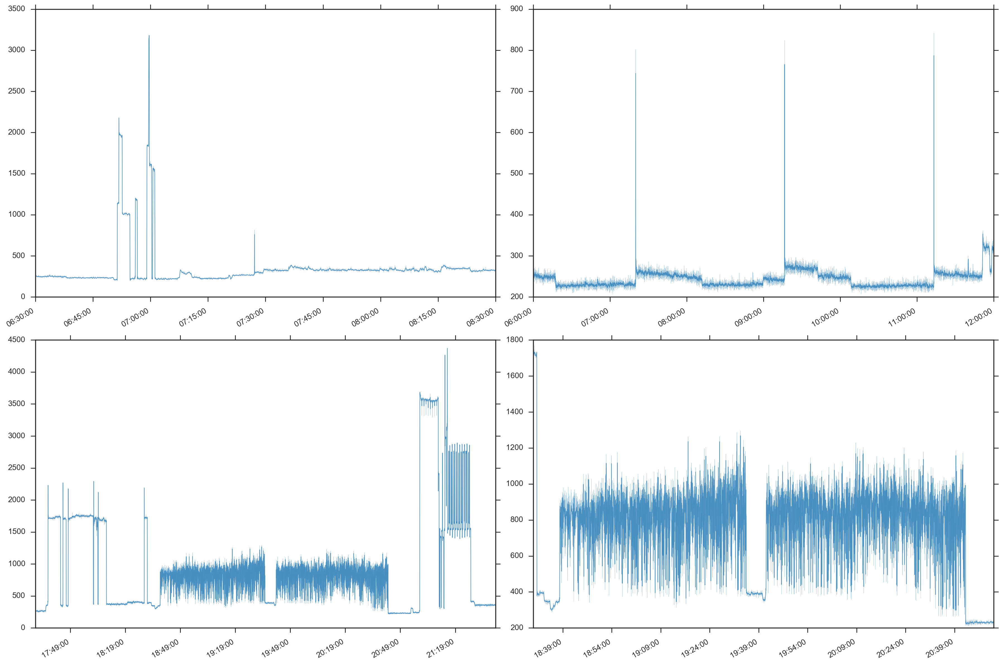

In [1175]:
# Subset of train data:
df_1 = train_ev.loc['2016-09-10'].between_time('8:30', '10:30')
df_2 = train_ev.loc['2016-09-08'].between_time('8:00', '14:00')

t0, tf = '2016-09-10 19:30', '2016-09-10 23:40'
df_3 = train_ev.loc[t0:tf]

t0, tf = '2016-09-10 20:30', '2016-09-10 22:50'
df_4 = train_ev.loc[t0:tf]

dfs_row = [df_1, df_2, df_3, df_4]
f, axes = plt.subplots(len(dfs_row) // 2, len(dfs_row) // 2, figsize=(18, 12))
for ax, df in zip(axes.ravel(), dfs_row):
    df.power.plot(ax=ax, lw=.25, color=tableau20[0], alpha=.4)
    df.wiener.plot(ax=ax, lw=.75, color=tableau20[0], alpha=.7)
    ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M:%S'))
    ax.set_xlabel('')
f.tight_layout()
plt.show()

['n', 'n_planos', 'mean_t', 'std_t', 'mean_planos', 'std_planos', 'mean_final', 'std_final', 'mean_u', 'std_u', 'pnorm', 'pnorm_next', 'error_cum']
last
661 660
rect_smoothing TOOK: 0.189 s


,n_ch,abs_ch,n,median_all,std_all,delta,step_v,rp,ts,ch,wiener,std_c
interv_shift,,,,,,,,,,,,
0,0,0,19,212.0,2.7,0,212,0,2016-09-10 08:51:00,True,2.899064,2.7
1,6,6,26,1140.0,298.6,928,1140,-1,2016-09-10 08:51:19,False,6.342287,-1.0
2,6,6,53,1968.0,124.4,827,1967,-1,2016-09-10 08:51:45,False,9.729994,-1.0
3,5,5,120,1010.0,109.1,-957,1010,-1,2016-09-10 08:52:38,False,6.296538,-1.0
4,6,6,85,223.0,112.1,-788,222,-1,2016-09-10 08:54:38,False,7.654935,-1.0
5,7,7,30,1185.0,216.0,963,1185,-1,2016-09-10 08:56:03,False,6.150531,-1.0
6,7,7,150,223.0,99.2,-963,222,-1,2016-09-10 08:56:33,False,5.560934,-1.0
7,7,7,27,1839.0,390.4,1618,1840,-1,2016-09-10 08:59:03,False,5.110207,-1.0
8,11,11,13,3134.0,503.3,1294,3134,-1,2016-09-10 08:59:30,False,17.533840,-1.0


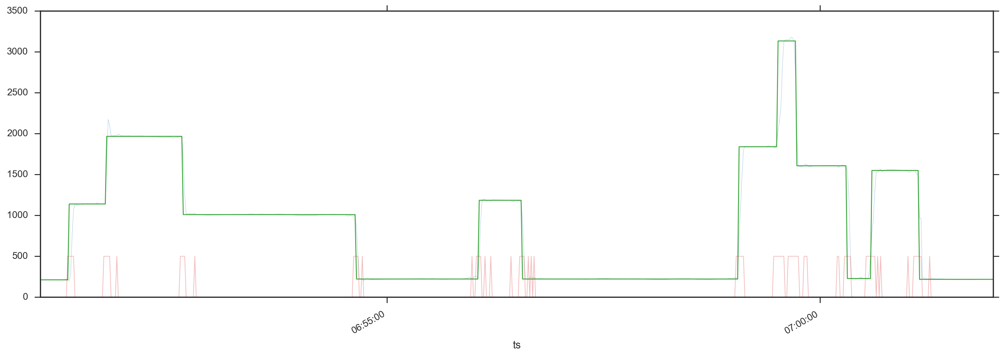

In [1180]:
FRAC_PLANO_INTERV = .9  # fracción de elementos planos (sin ∆ apreciable) en el intervalo
N_MIN_FRAC_PLANO = 10    # Nº mínimo de elems en intervalo para aplicar FRAC_PLANO_INTERV
P_OUTLIER = .95
P_OUTLIER_SAFE = .99

MIN_EVENT_T = 6
MIN_VALIDOS = 3
MIN_STD = 20


def _es_outlier(pnorm, p_limit=P_OUTLIER):
    if (pnorm < 1 - p_limit) or (pnorm > p_limit):
        return True
    return False
    
def _cambio_futuro(std1, std2, m1, m2):
    d = abs(m1 - m2)
    m = (m1 + m2) / 2.
    
    dc = abs(std1 - std2)
    mc = (std1 + std2) / 2.
    #if (((std1 < 50) and (std2 > 100)) or ((std2 < 50) and (std1 > 100))) and ((d > 1000) or (d / m > 1)):
    if ((dc > 100) or (dc / mc > 5)) or ((d > 1000) or (d / m > 1)):
        return True
    return False
    

# Detección de intervalos
@timeit('rect_smoothing', verbose=True)
def rect_smoothing(df, verbose=False):
    N = df.shape[0]
    is_start_event = np.zeros(N, dtype=np.bool)
    change = np.zeros(N, dtype=np.int8)
    step = np.zeros(N, dtype=np.int)
    step_med = np.zeros(N, dtype=np.int)

    temp = np.zeros((N, 13))
    counter_deb = 0
    cols_deb = 'n, n_planos, mean_t, std_t, mean_planos, std_planos, mean_final, std_final, mean_u, std_u, pnorm, pnorm_next, error_cum'.split(', ')
    print_ok(cols_deb)

    c_interval = c_interval_ch = None
    last_idx_ch = last_step = last_std = n = 0
    idx_ch_ant = 0
    f_planos = lambda interval, interval_ch: np.array(interval)[np.nonzero(np.array(interval_ch) == 0)]

    for i, (p, hay_ch_abs, incr, next_incr, next_std, next_mean
           ) in enumerate(zip(df['wiener'], df['abs_ch'], 
                              df['delta_wiener'].shift(-1), df['delta_wiener'].shift(-2), 
                              df['r_std'], df['r_mean'])):
        sufficient_event = n > MIN_EVENT_T
        hay_ch_min = (abs(incr) > 15) or (abs(incr + next_incr) > 30)
        if i == 0:
            c_interval, c_interval_ch = [p], [0]
            c_interval_ant, c_interval_ch_ant = [p], [0]
            n += 1
        elif i == N - 3:
            print('last')
            c_interval.append(p)
            c_interval_ch.append(hay_ch_min)
            last_step = np.mean(c_interval)
            step[last_idx_ch:] = np.int(np.mean(c_interval))
            step_med[last_idx_ch:] = np.int(np.median(c_interval))
            change[last_idx_ch:-2] = np.array(c_interval_ch, dtype=np.int8)
        elif not sufficient_event:
            c_interval.append(p)
            c_interval_ch.append(hay_ch_min)
            n += 1
        else:
            dir_ch = 0
            if hay_ch_abs:
                dir_ch = 1 if incr > 0 else -1
            v_planos = f_planos(c_interval, c_interval_ch)
            n_planos = v_planos.shape[0]

            std_t = np.std(c_interval[2:])
            mean_t = np.mean(c_interval[2:])
            err_dist = std_t / np.sqrt(n - 2)

            deb_hay_planos = deb_usa_final = deb_usar = 0

            if n_planos > 3:
                deb_hay_planos = 1
                std_planos = np.std(v_planos)
                mean_planos = np.mean(v_planos)
                err_dist_p = std_planos / np.sqrt(n_planos)
            else:
                std_planos = std_t
                mean_planos = mean_t
                err_dist_p = err_dist

            if n_planos > 2 * ROLL_WINDOW_STD:
                deb_usa_final = 1
                std_final = np.std(v_planos[-(2 * ROLL_WINDOW_STD):])
                mean_final = np.mean(v_planos[-(2 * ROLL_WINDOW_STD):])
                err_dist_f = std_final / np.sqrt(len(v_planos[-(2 * ROLL_WINDOW_STD):]))
            else:
                std_final = std_planos
                mean_final = mean_planos
                err_dist_f = err_dist_p

            if (n > N_MIN_FRAC_PLANO) and (n_planos / n > FRAC_PLANO_INTERV):
                deb_usar = 1
                #std_u = std_planos
                #mean_u = mean_planos
                #err_dist_u = err_dist_p
                std_u = std_final
                mean_u = mean_final
                err_dist_u = err_dist_f
            #elif (n > N_MIN_FRAC_PLANO):
            #    deb_usar = 2
            #    std_u = std_final
            #    mean_u = mean_final
            #    err_dist_u = err_dist_f
            else:
                deb_usar = 3
                std_u = std_t
                mean_u = mean_t
                err_dist_u = err_dist

            # Condición de intervalo diferente al anterior para k y k+1:
            pnorm = scipy.stats.norm.cdf(p, mean_u, min(150, std_u + err_dist_u))
            pnorm_next = scipy.stats.norm.cdf(p + next_incr, mean_u, min(150, std_u + err_dist_u))

            # DEBUG
            interv_considerados = np.array(c_interval[2:])
            error_cum = np.sqrt(np.mean((interv_considerados - np.mean(interv_considerados))**2))
            temp[i, :] = [n, n_planos, mean_t, std_t, mean_planos, std_planos, mean_final, std_final, mean_u, std_u, pnorm, pnorm_next, error_cum]

            # Lógica de detección de eventos:
            next_dif_mean_supera_std = abs(mean_u - next_mean) > std_u
            es_outlier_safe = _es_outlier(pnorm, P_OUTLIER_SAFE)
            es_outlier = _es_outlier(pnorm, P_OUTLIER_SAFE)
            next_es_outlier_safe = _es_outlier(pnorm_next, P_OUTLIER_SAFE)
            next_es_outlier = _es_outlier(pnorm_next, P_OUTLIER_SAFE)
            hay_cambio_futuro = _cambio_futuro(std_final, next_std, mean_final, next_mean)
            hay_incr_considerar = abs(incr) > 10

            vip = ((hay_ch_abs and next_dif_mean_supera_std and es_outlier and next_es_outlier_safe)
                  or (hay_incr_considerar and es_outlier and next_es_outlier_safe and hay_cambio_futuro))
            if sufficient_event and vip: # and (c_interval_ch[-1] == 0) and (c_interval_ch[-2] == 0):
                # debug:
                if verbose:
                    print_magenta('\n{} --> {:.0f}, {:.0f}, {:.0f}, {:.1f}, {:.0f}, {:.1f}, {:.0f}, {:.1f}, {:.0f}, {:.1f}, {:.7f}, {:.7f}'.format(counter_deb, *temp[i,:]))
                    print(incr, hay_incr_considerar, hay_ch_abs, next_dif_mean_supera_std, es_outlier, es_outlier_safe, next_es_outlier, next_es_outlier_safe, hay_cambio_futuro)
                    cad_deb = 'deb_hay_planos={}, deb_usa_final={}, deb_usar={}'.format(deb_hay_planos, deb_usa_final, deb_usar)
                    if hay_ch_abs and _es_outlier(pnorm, P_OUTLIER_SAFE) and _es_outlier(pnorm_next, P_OUTLIER_SAFE):
                        print_info('* p={:.0f} W, salto ch_abs={:.1f} y safe_outlier: [{:.5f}, {:.5f}]; {}, error_cum={:.2f}'
                                   .format(p, incr, pnorm, pnorm_next, cad_deb, error_cum))
                    else:
                        print_cyan('con p={:.0f} W, salto por cambio_futuro. std: {:.1f} -> {:.1f}, mean: {:.1f} -> {:.1f}; y safe_outlier: [{:.7f}, {:.7f}]; {}, error_cum={:.2f}'
                                   .format(p, std_final, next_std, mean_final, next_mean, pnorm, pnorm_next, cad_deb, error_cum))
                    print_red('{:%H:%M:%S} => m_u={:.1f}, std_u={:.1f}, e_u={:.1f}, last_step={:.1f}, last_std={:.1f}, roll_std={:.1f}, p={:.7f}'
                              .format(df.index[i], mean_u, std_u, err_dist_u, last_step, last_std, next_std, pnorm))
                #if counter_deb > 50:
                #    break
                #if n_planos > 5:
                #    last_step = np.median(v_planos)
                #    last_std = np.std(v_planos)
                #else:
                #    last_step = np.median(c_interval)
                #    last_std = np.std(c_interval)
                last_step = np.mean(c_interval)
                last_std = np.std(c_interval)
                
                is_start_event[i] = True
                step[last_idx_ch:i] = np.int(np.mean(c_interval))
                step_med[last_idx_ch:] = np.int(np.median(c_interval))
                change[last_idx_ch:i] = np.array(c_interval_ch, dtype=np.int8)
                
                idx_ch_ant = last_idx_ch
                c_interval_ant, c_interval_ch_ant = c_interval, c_interval_ch
                c_interval, c_interval_ch = [p], [vip]
                last_idx_ch = i
                n = 1
                counter_deb += 1
                error_cum = 0
            else:
                #if (counter_deb == 4) and (i % 3 == 0):
                #    print_red('{} [{:%H:%M:%S}], {:.0f} W --> {:.0f}, {:.0f}, {:.0f}, {:.1f}, {:.0f}, {:.1f}, {:.0f}, {:.1f}, {:.0f}, {:.1f}, {:.7f}, {:.7f}'
                #              .format(counter_deb, df.index[i], p, *temp[i,:]))
                c_interval.append(p)
                c_interval_ch.append(hay_ch_min)
                n += 1
    print(N, i)
    df_step = pd.DataFrame({'step_median': step_med, 'step_mean': step, 'ch': change, 'is_init': is_start_event},
                           columns=['step_median', 'step_mean', 'ch', 'is_init'], index=df.index)
    df_debug = pd.DataFrame(temp, columns=cols_deb, index=df_step.index)
    return df_step, df_debug


def _std_nonzero(x):
    N = x.shape[0]
    #idx_act = np.nonzero(x.ch == 0)[0]
    
    #interv.ix[np.nonzero(x.ch)[0][-1] + 1:].wiener.std()
    
    idx_act = np.nonzero(x.ch)[0]
    if len(idx_act) == 0:
        #print_red(x.ch)
        return np.std(x.wiener)
    elif idx_act[-1] + 1 < N:
        v_usar = x.wiener.values[idx_act[-1] + 1:]
        #print(N, idx_act[-1] + 1, len(v_usar))
        return np.std(v_usar)
    else:
        #print(N, idx_act, '\n', x)
        return -1


def _valid_ch(interv_ch):
    idx_act = np.nonzero(interv_ch)[0]
    if (len(idx_act) == 0) or (idx_act[-1] + 1 < len(interv_ch)):
        return True
    else:
        return False


def genera_df_intervalos(df_data, df_step):
    train_step_t = df_data[['wiener']].join(df_step)
    train_step_t['interv_shift'] = train_step_t.is_init.cumsum().shift(-1).fillna(method='ffill').astype(int)
    gb = train_step_t.tz_localize(None).reset_index().groupby('interv_shift')
    df_interv = pd.concat([gb.ch.apply(lambda x: sum(abs(x))).rename('n_ch'),
                           gb.ch.sum().rename('abs_ch'),
                           gb.ch.count().rename('n'),
                           gb.wiener.median().rename('median_all').round(),
                           gb.wiener.std().rename('std_all').round(1),
                           gb.step_median.last().rename('delta') - gb.step_median.first().values,
                           gb.step_median.last().rename('step_v'),
                           gb.ch.apply(_first_index_permanent).rename('rp'),
                           gb.ts.first(),
                           gb.ch.apply(_valid_ch),
                           gb.wiener.apply(lambda x: np.std(x[5:])),
                           gb.apply(_std_nonzero).round(1).rename('std_c')], axis=1)
    return df_interv


def plot_steps_detection(df_data, df_step):
    ax = df_data.wiener.plot(figsize=(18, 6), lw=.5, alpha=.3, color=tableau20[0])
    df_step.step_median.plot(ax=ax, lw=1, alpha=.9, color=tableau20[4])
    (df_step.ch.abs() * 500).plot(ax=ax, lw=.75, alpha=.3, color=tableau20[6])
    ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M:%S'))
    return ax


# Detección de intervalos
df = df_1.between_time('8:51', '9:02')

df_step, df_debug = rect_smoothing(df, verbose=False)

# INTERVALOS:
df_interv = genera_df_intervalos(df, df_step)

# Show
plot_steps_detection(df, df_step)
df_interv.tail(15)

['n', 'n_planos', 'mean_t', 'std_t', 'mean_planos', 'std_planos', 'mean_final', 'std_final', 'mean_u', 'std_u', 'pnorm', 'pnorm_next', 'error_cum']
last
901 900
rect_smoothing TOOK: 0.505 s


,n_ch,abs_ch,n,median_all,std_all,delta,step_v,rp,ts,ch,wiener,std_c
interv_shift,,,,,,,,,,,,
0,0,0,901,269.0,34.5,0,268,0,2016-09-08 13:45:00,True,34.459223,34.5


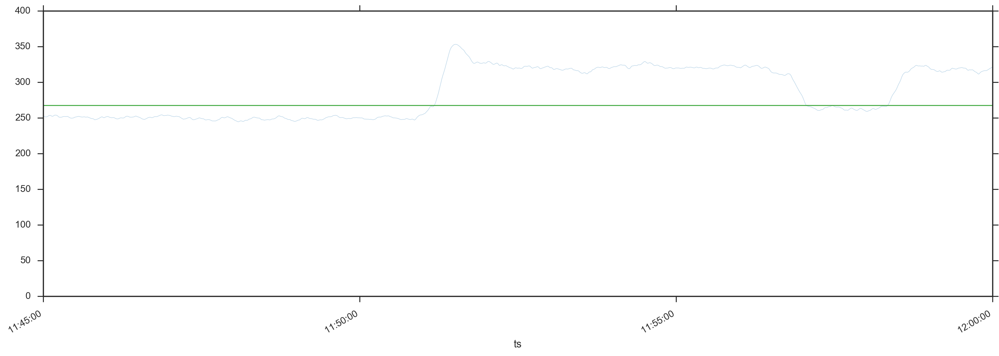

In [1181]:
df = df_2.between_time('13:45', '15:30')

df_step, df_debug = rect_smoothing(df, verbose=True)
df_interv = genera_df_intervalos(df, df_step)
plot_steps_detection(df, df_step)
df_interv.tail(15)

['n', 'n_planos', 'mean_t', 'std_t', 'mean_planos', 'std_planos', 'mean_final', 'std_final', 'mean_u', 'std_u', 'pnorm', 'pnorm_next', 'error_cum']
last
15060 15059
rect_smoothing TOOK: 5.909 s


,n_ch,abs_ch,n,median_all,std_all,delta,step_v,rp,ts,ch,wiener,std_c
interv_shift,,,,,,,,,,,,
0,0,0.0,407,266.0,32.2,0,265,0,2016-09-10 19:30:00,True,32.292880,32.1
1,3,3.0,7,412.0,12.5,150,415,-1,2016-09-10 19:36:47,False,6.377981,-1.0
2,6,6.0,402,1721.0,71.6,1305,1720,10,2016-09-10 19:36:54,True,11.955181,11.7
3,3,3.0,7,1726.0,8.2,4,1724,-1,2016-09-10 19:43:36,False,5.901726,-1.0
4,5,5.0,78,348.0,198.2,-1377,347,-1,2016-09-10 19:43:43,False,8.567637,-1.0
5,8,8.0,105,1706.0,181.6,1358,1705,8,2016-09-10 19:45:01,True,6.859318,6.0
6,6,6.0,69,344.0,255.2,-1362,343,-1,2016-09-10 19:46:46,False,4.870726,-1.0
7,7,7.0,818,1748.0,53.5,1405,1748,-1,2016-09-10 19:47:55,False,15.602405,-1.0
8,8,8.0,15,387.0,620.0,-1362,386,-1,2016-09-10 20:01:33,False,117.232783,-1.0


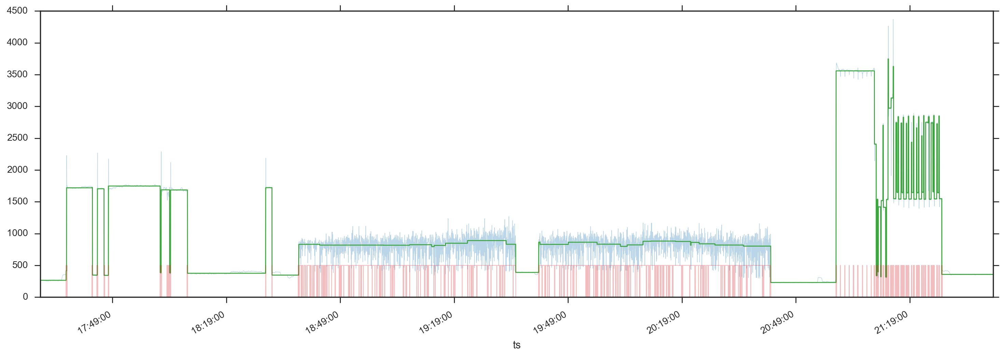

In [1182]:
df = df_3

df_step, df_debug = rect_smoothing(df, verbose=False)
df_interv = genera_df_intervalos(df, df_step)
plot_steps_detection(df, df_step)
df_interv.head(15)

['n', 'n_planos', 'mean_t', 'std_t', 'mean_planos', 'std_planos', 'mean_final', 'std_final', 'mean_u', 'std_u', 'pnorm', 'pnorm_next', 'error_cum']
last
8460 8459
rect_smoothing TOOK: 2.984 s


,n_ch,abs_ch,n,median_all,std_all,delta,step_v,rp,ts,ch,wiener,std_c
interv_shift,,,,,,,,,,,,
0,1,1.0,60,1719.0,6.5,0,1719,-1,2016-09-10 20:30:00,False,6.618541,-1.0
1,7,7.0,423,347.0,124.3,-1372,347,-1,2016-09-10 20:31:00,False,29.837936,-1.0
2,203,203.0,331,832.0,75.1,484,831,-1,2016-09-10 20:38:03,False,70.376480,-1.0
3,936,936.0,1006,820.0,104.5,-12,819,-1,2016-09-10 20:43:34,False,103.723362,-1.0
4,394,394.0,415,817.0,113.0,-2,817,-1,2016-09-10 21:00:20,False,112.002086,-1.0
5,321,321.0,349,829.0,130.2,8,825,-1,2016-09-10 21:07:15,False,124.121604,-1.0
6,39,39.0,40,796.0,145.4,-30,795,-1,2016-09-10 21:13:04,False,94.452312,-1.0
7,168,168.0,178,814.0,140.0,19,814,-1,2016-09-10 21:13:44,False,129.622805,-1.0
8,331,331.0,348,849.0,141.2,34,848,-1,2016-09-10 21:16:42,False,135.801258,-1.0


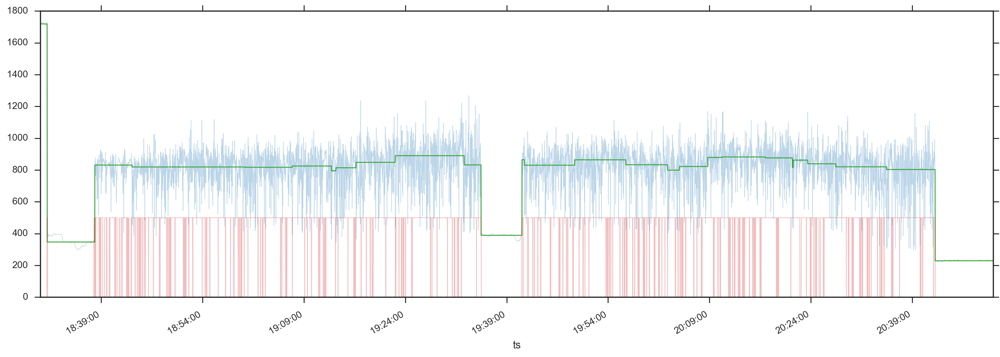

In [1183]:
df = df_4

df_step, df_debug = rect_smoothing(df, verbose=False)
df_interv = genera_df_intervalos(df, df_step)
plot_steps_detection(df, df_step)
df_interv.head(15)

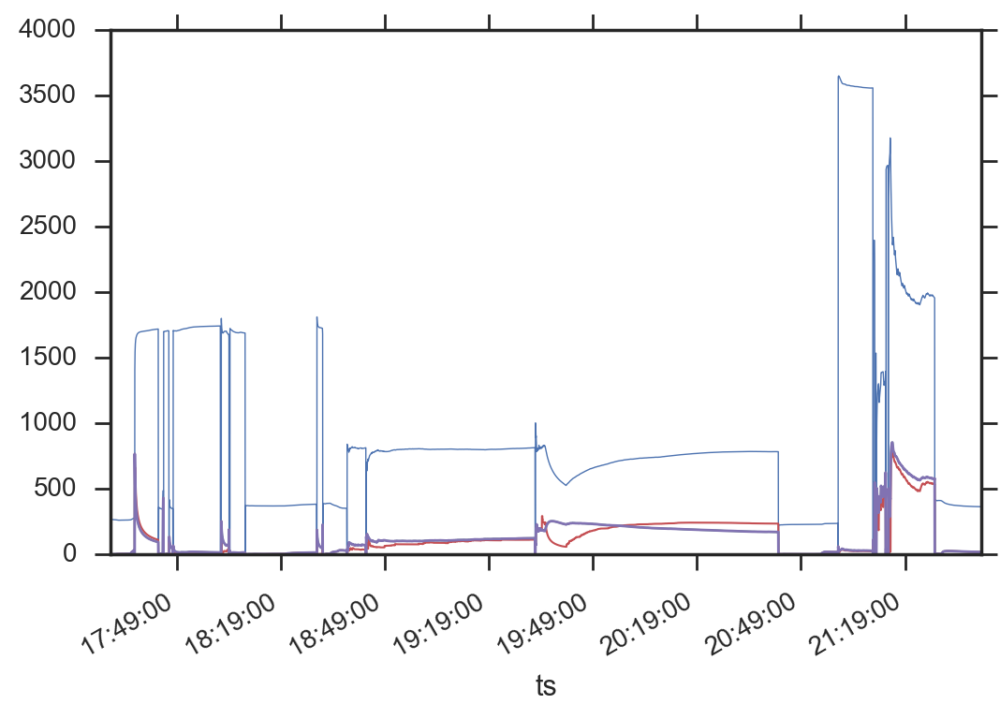

In [1076]:
ax = df_debug.mean_t.plot(lw=.5)
df_debug.std_t.plot(ax=ax, lw=.75)
df_debug.std_planos.plot(ax=ax, lw=.75)
#df_debug.plot(ax=ax, lw=.75)
(df_debug.error_cum).plot(ax=ax, lw=1)
ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M:%S'))

In [1218]:
pd.read_hdf('/Users/uge/Desktop/bkp_enerpidata/OLD_STORES/enerpi_data.h5', 'rms')

,power,noise,ref,ldr
ts,,,,
2016-09-30 23:47:08.822574,409.085131,0.007980,82.0,0.572637
2016-09-30 23:47:09.823459,409.990919,0.007897,83.0,0.572953
2016-09-30 23:47:10.834189,405.138188,0.007908,84.0,0.572625
2016-09-30 23:47:11.839873,398.097771,0.007941,83.0,0.571583
2016-09-30 23:47:12.839493,390.990458,0.007993,83.0,0.572979
2016-09-30 23:47:13.842946,400.681145,0.008088,82.0,0.573702
2016-09-30 23:47:14.844327,407.380119,0.008004,83.0,0.573695
2016-09-30 23:47:15.855025,402.797251,0.007884,84.0,0.573720
2016-09-30 23:47:16.866262,401.374555,0.007944,84.0,0.573830


In [1217]:
#pd.read_hdf('/Users/uge/Desktop/bkp_enerpidata/OLD_STORES/enerpi_data.h5', 'rms')
with pd.HDFStore('/Users/uge/Desktop/bkp_enerpidata/OLD_STORES/enerpi_data.h5', 'r') as st:
    print_info(st)
    bad = st.select('rms', start=0, stop=324324)
    
print_ok(bad.head())
bad.tail()

<class 'pandas.io.pytables.HDFStore'>
File path: /Users/uge/Desktop/bkp_enerpidata/OLD_STORES/enerpi_data.h5
/rms            frame_table  (typ->appendable,nrows->324720,ncols->4,indexers->[index])
                                 power     noise   ref       ldr
ts                                                              
2016-09-30 23:47:08.822574  409.085131  0.007980  82.0  0.572637
2016-09-30 23:47:09.823459  409.990919  0.007897  83.0  0.572953
2016-09-30 23:47:10.834189  405.138188  0.007908  84.0  0.572625
2016-09-30 23:47:11.839873  398.097771  0.007941  83.0  0.571583
2016-09-30 23:47:12.839493  390.990458  0.007993  83.0  0.572979


,power,noise,ref,ldr
ts,,,,
2016-10-04 19:11:42.719309,384.341113,0.008907,84.0,0.349165
2016-10-04 19:11:43.730063,381.263119,0.008942,84.0,0.349026
2016-10-04 19:11:44.740648,377.687808,0.008912,84.0,0.348697
2016-10-04 19:11:45.751194,382.461445,0.008852,84.0,0.348306
2016-10-04 19:11:46.761756,383.779337,0.008875,84.0,0.348732


In [ ]:
    bad = st.select

In [ ]:
    bad = st.get

## STEP-SMOOTHING

Para la detección de **eventos y niveles**, partiendo de la señal de 'power' filtrada con un filtro *wiener*,
se analizan los cambios en el tiempo, suponiendo **saltos** de nivel mediante la *rectangularización* de la señal.

Se marcan los instantes de cambio (subida o bajada), y se utiliza como valor del nivel la **mediana** de los instantes sin cambio dentro de cada **intervalo** (periodos de señal aproximadamente constante, conforme a un intervalo de probabilidad del 90%, suponiendo una distribución normal de los valores dentro del intervalo (-> media + std).

In [893]:
interv = train_step_t[train_step_t.interv_shift == 1]
#interv.ix[np.nonzero(interv.ch == 0)]
interv
interv.ix[np.nonzero(interv.ch)[0][-1] + 1:].wiener.std(), interv.ix[np.nonzero(interv.ch == 0)].wiener.std(), interv.wiener.std()

(5.361856226837775, 116.65976577362194, 170.805766244448)

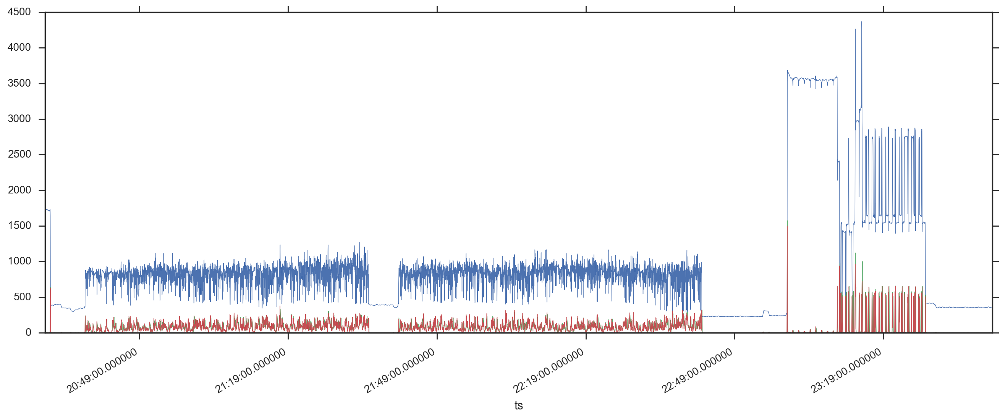

In [690]:
ax = df_test.wiener.plot(lw=.5, figsize=(16, 6))
df_test.wiener.rolling(7).std().plot(lw=.5, ax=ax)
df_test.wiener.rolling(5, center=True).std().plot(lw=.5, ax=ax)
#df_test.wiener.rolling(15, center=True).std().plot(lw=.5, ax=ax)

plot_tt_fft TOOK: 0.156 s


array([<matplotlib.axes._subplots.AxesSubplot object at 0x1337c0f98>,
       <matplotlib.axes._subplots.AxesSubplot object at 0x137f19fd0>], dtype=object)

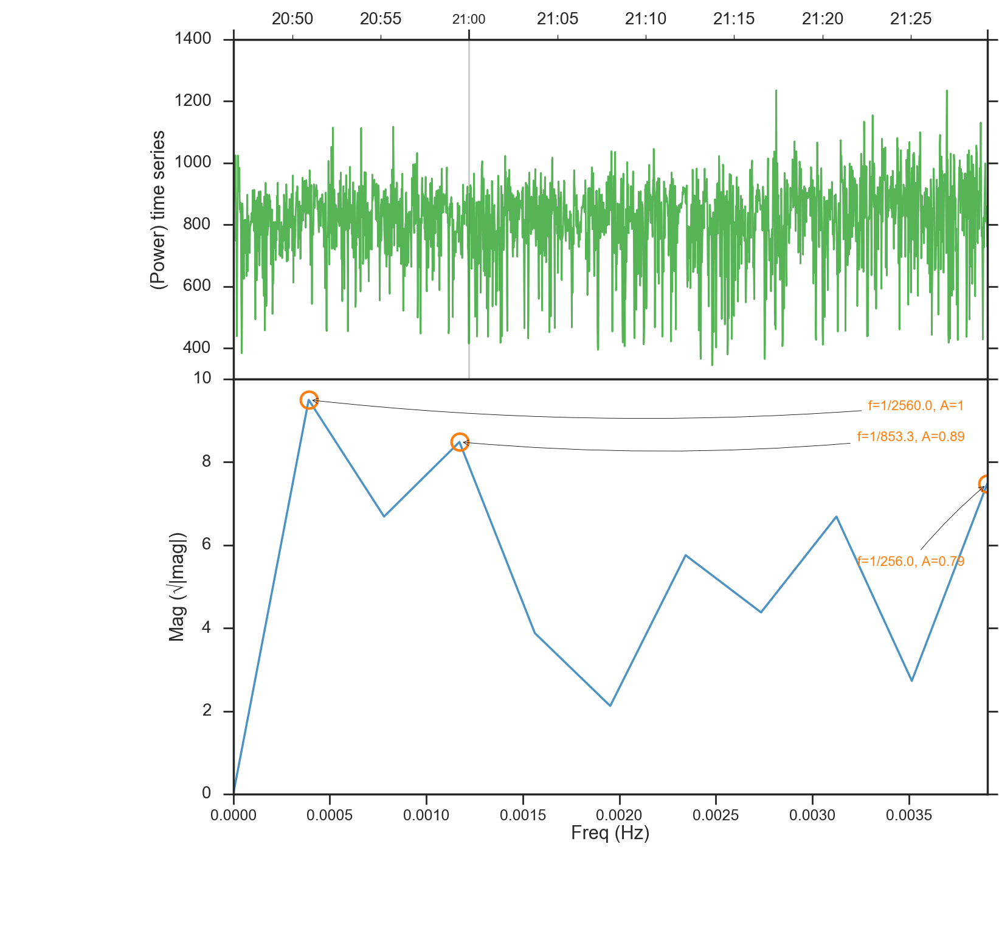

In [632]:
plot_tt_fft(df_test.iloc[1000:-700].wiener, max_freq=5, best_freqs=10)


In [570]:
c_interval = train.loc[df_step[df_step.interv_shift == n_interv].index, 'wiener'].tolist()
c_interval_ch = df_step[df_step.interv_shift == n_interv].ch.tolist()

%memit validos = [v for i, v in enumerate(c_interval) if c_interval_ch[i] == 0]
%timeit validos = [v for i, v in enumerate(c_interval) if c_interval_ch[i] == 0]

%memit validos_np = np.array(c_interval, dtype=np.int)[np.nonzero(np.array(c_interval_ch, dtype=np.int8) == 0)]
%timeit validos_np = np.array(c_interval, dtype=np.int)[np.nonzero(np.array(c_interval_ch, dtype=np.int8) == 0)]

print(len(c_interval), len(validos), np.mean(validos), len(validos_np), np.mean(validos_np))

peak memory: 1691.92 MiB, increment: 0.00 MiB
1000 loops, best of 3: 219 µs per loop
peak memory: 1692.00 MiB, increment: 0.00 MiB
10000 loops, best of 3: 28.9 µs per loop
150 147 229.044993624 147 228.544217687


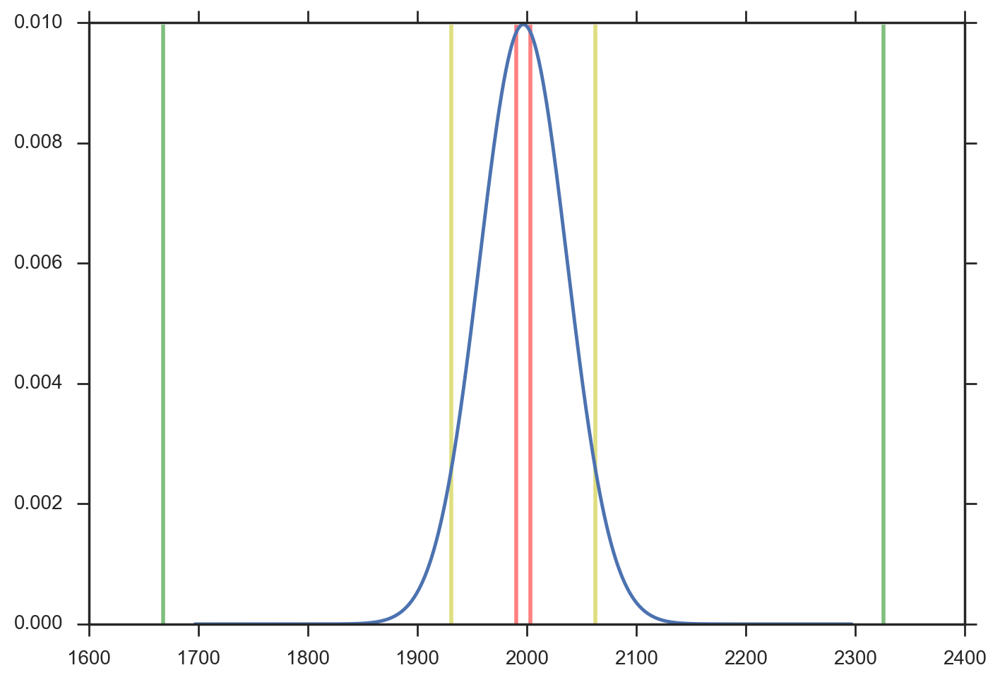

In [481]:
mean = 1997
std = 40
offset = 300
p = .9

x_p = np.linspace(mean - offset, offset + mean, 2*offset + 1)
curva_p = scipy.stats.norm.pdf(x_p, mean, std)
plt.plot(x_p, curva_p)
plt.vlines(scipy.stats.norm.interval(p, mean, std / 10), 0, np.max(curva_p), color='r', lw=2, alpha=.5)
plt.vlines(scipy.stats.norm.interval(p, mean, std), 0, np.max(curva_p), color='y', lw=2, alpha=.5)
plt.vlines(scipy.stats.norm.interval(p, mean, 5 * std), 0, np.max(curva_p), color='g', lw=2, alpha=.5)

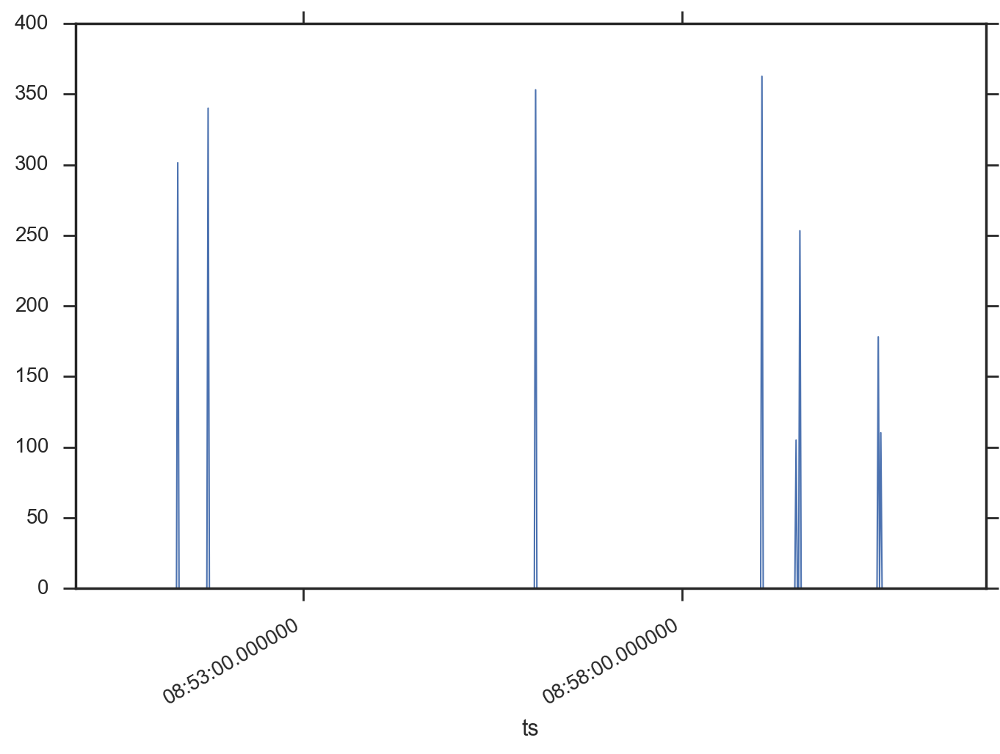

In [260]:
def _f_roll_difs(x):
    if (np.sum(x) > 50) and (x[len(x) // 2 + 1] == np.max(x)):
        return x[len(x) // 2 + 1] - (x[0] + x[-1]) / 2
    return 0


df_1.wiener.diff().rolling(5, center=True).apply(_f_roll_difs).plot(lw=.75)

        22  -1    35   34   46   6    1    47   14   36 ...    3    42   9    38   26   48   27   29   21   4 
k_hd  8224  556  429  198   90   58   34   29   25   24 ...     6    6    6    5    5    5    5    5    5    5

[1 rows x 50 columns]


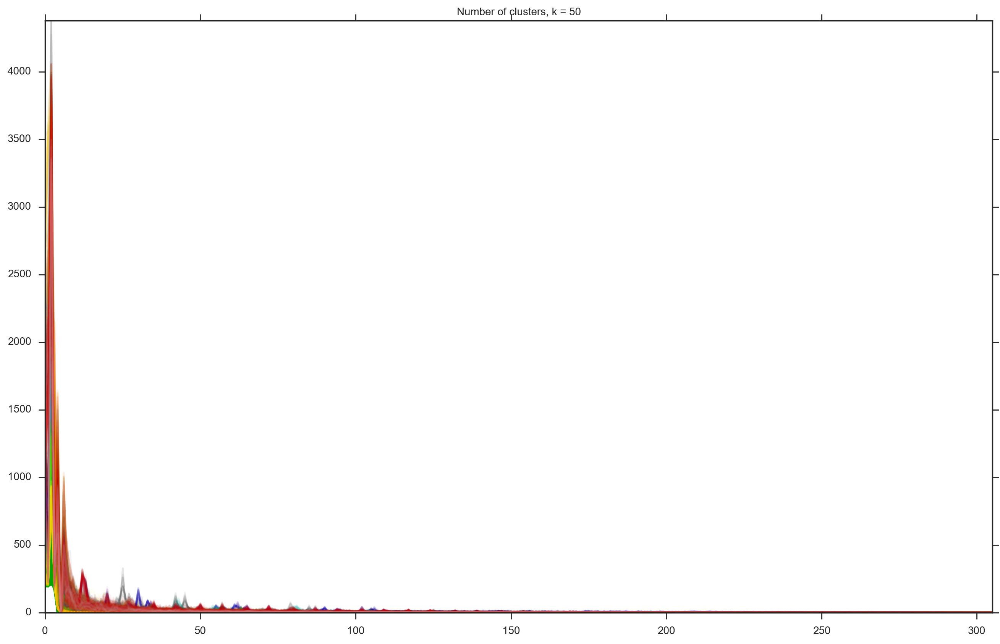

In [178]:
m_hd = HDBSCAN(min_cluster_size=5, min_samples=None, p=.5)
m_hd.fit(X)

labels_hd = pd.Series(m_hd.labels_, name='k_hd', index=df_train.T.index)
print_info(pd.DataFrame(labels_hd.value_counts()).T)
plot_clustering(X, m_hd.labels_)

            17  -1    23   19   33   34   10   18   13   5  ...    3    21   35   25   12   7    24   16   8    0 
k_hd_fft  9010  669   47   25   22   20   20   20   15   14 ...     6    6    5    5    5    5    5    5    5    5

[1 rows x 37 columns]


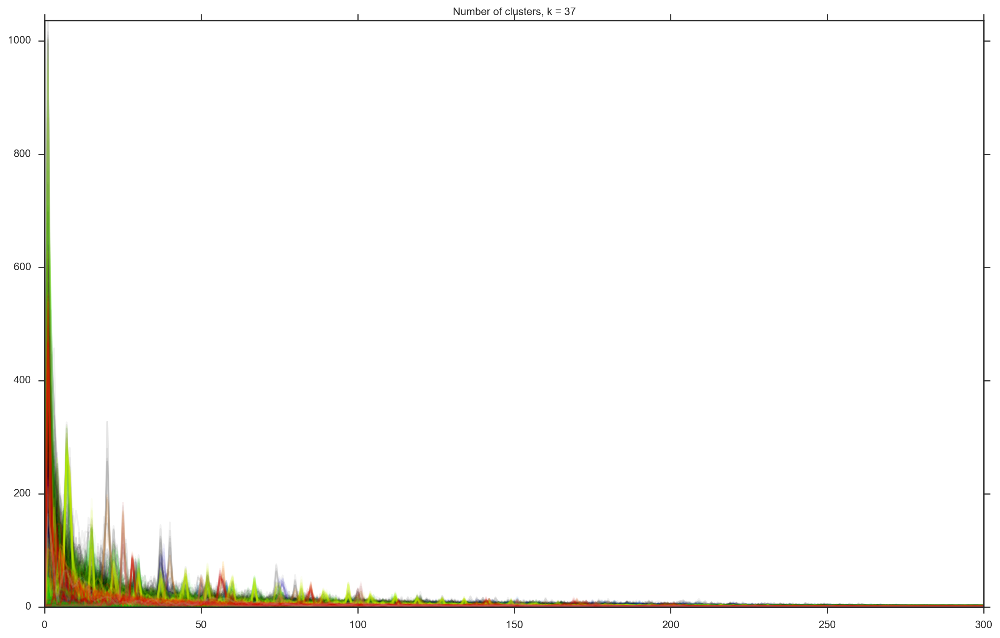

In [177]:
m_hd_fft = HDBSCAN(min_cluster_size=5, min_samples=None, p=.5)
m_hd_fft.fit(df_fft_train.T.values)

labels_hdfft = pd.Series(m_hd_fft.labels_, name='k_hd_fft', index=df_fft_train.T.index)
print_info(pd.DataFrame(labels_hdfft.value_counts()).T)

plot_clustering(df_fft_train.T.values, m_hd_fft.labels_)

            7    4   3   0   2   14  1   13  8   5   12  6   11  10  9 
k_ag_fft  9567  379  45  43   9   6   6   5   4   3   3   2   2   1   1


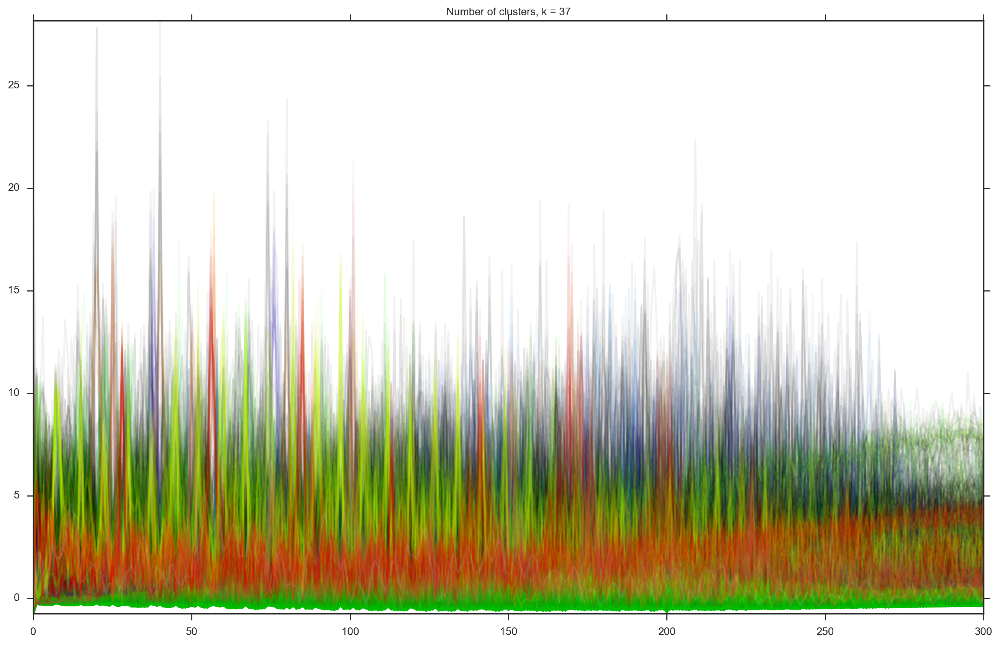

In [179]:
std_scaler = StandardScaler()
X_std_fft = std_scaler.fit_transform(df_fft_train.T.values)
m_ag_fft = AgglomerativeClustering(n_clusters=15, linkage='average', affinity='manhattan')
m_ag_fft.fit(X_std_fft)

labels_ag = pd.Series(m_ag.labels_, name='k_ag_fft', index=df_fft_train.T.index)
print_info(pd.DataFrame(labels_ag.value_counts()).T)

plot_clustering(X_std_fft, m_hd_fft.labels_)

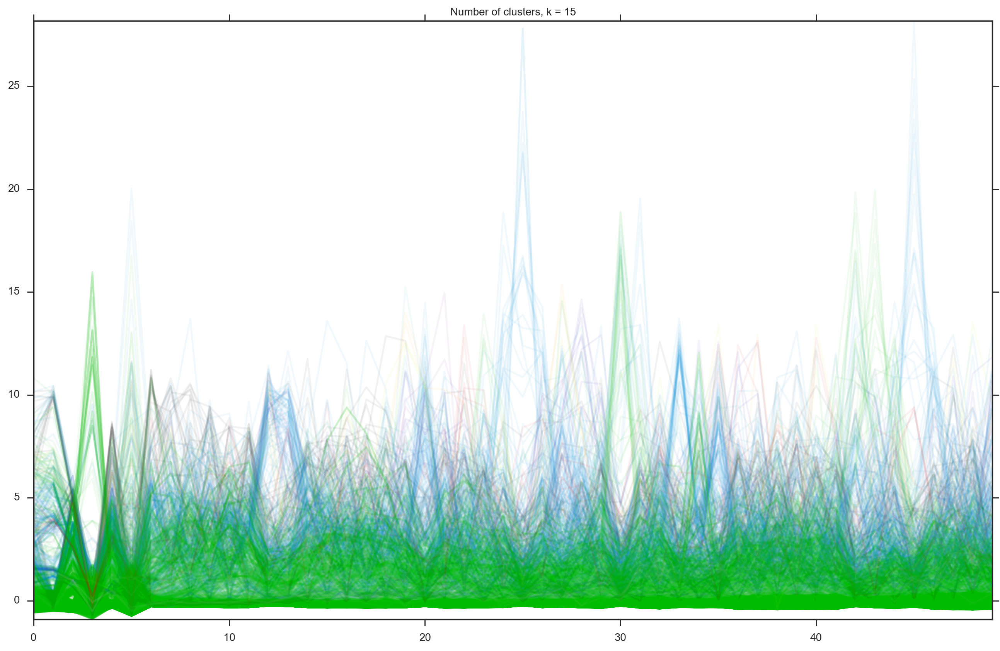

In [163]:
plot_clustering(X_std[:,:50], m_ag.labels_, title=None,
                     core_samples_mask=None, cluster_centers_indices=None, cluster_centers=None, force_scatter=False,
                     ax=None)

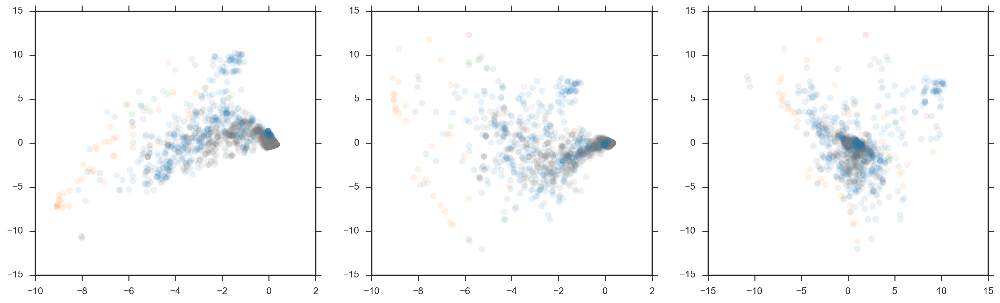

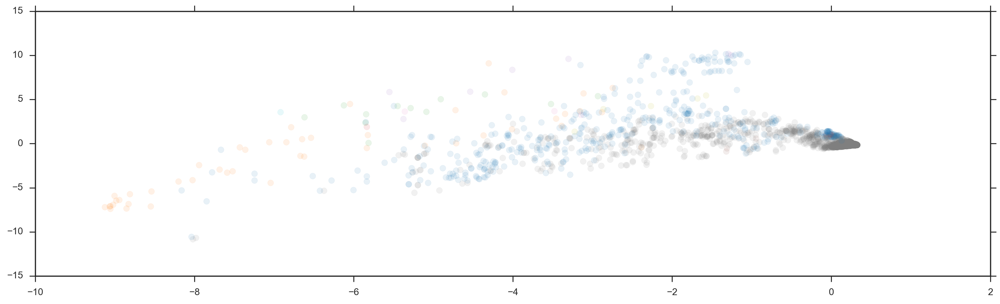

In [192]:
_plot_reduced_clustering(X_pca3_fft, m_ag_fft.labels_, lw=.25, s=40)
_plot_reduced_clustering(X_pca_fft, m_ag_fft.labels_, lw=.25, s=40)

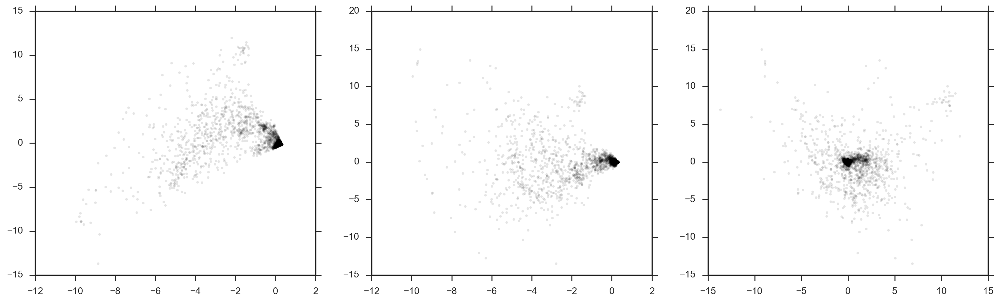

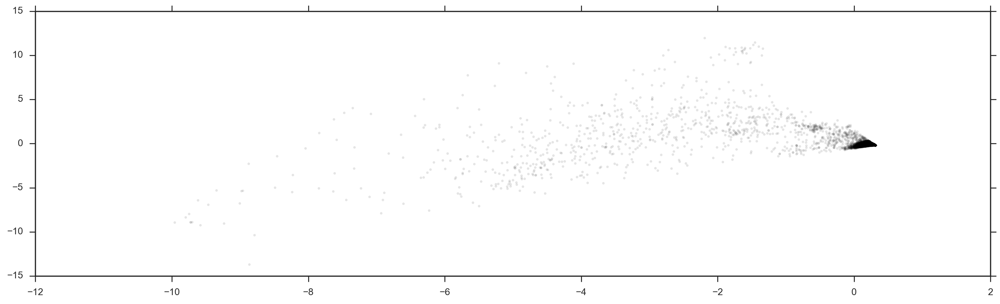

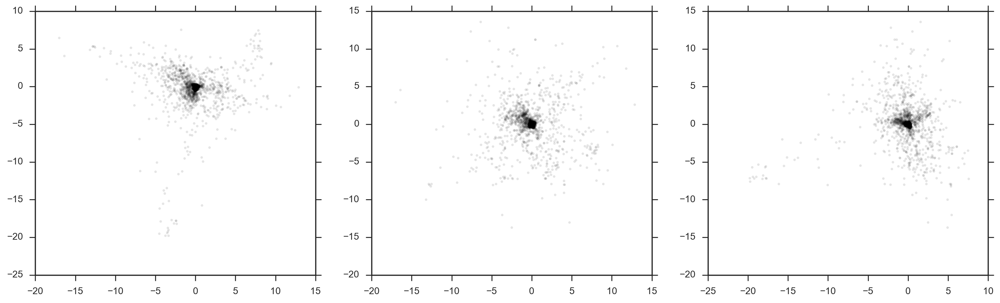

In [318]:
#_plot_reduced_clustering(X_pca3, axes3d=True)
_plot_reduced_clustering(X_pca3)
_plot_reduced_clustering(X_pca)
_plot_reduced_clustering(X_pca20[:,3:])

In [10]:
tsne = TSNE(n_components=2)
X_tsne20 = tsne.fit_transform(X_pca20)
X_tsne20

array([[  2.65288395e+09,   1.17796272e+09],
       [ -1.40147500e+09,   1.22549892e+09],
       [ -2.30188215e+09,  -4.89397096e+10],
       ..., 
       [ -1.03867788e+09,   4.88090224e+09],
       [  2.35322093e+09,   8.74369752e+09],
       [ -4.11570449e+07,  -5.06879639e+08]])

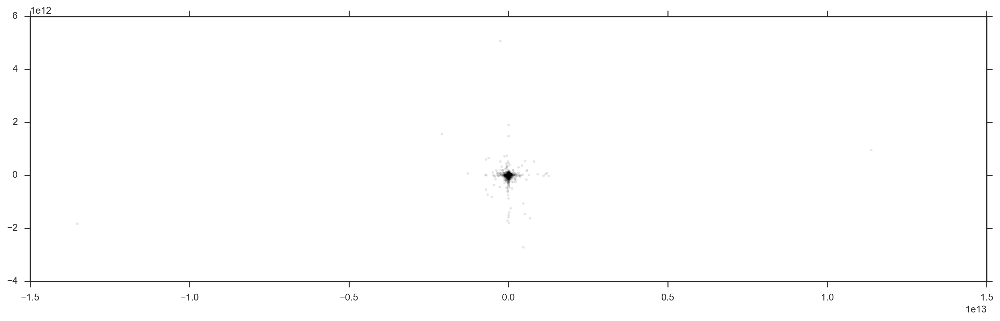

In [18]:
_plot_reduced_clustering(X_tsne20)

Estimated number of clusters: 9
                 -1     7    4    6   2   3   0   5   1
Label members  6350  4839  720  352  48  47  25  19  19


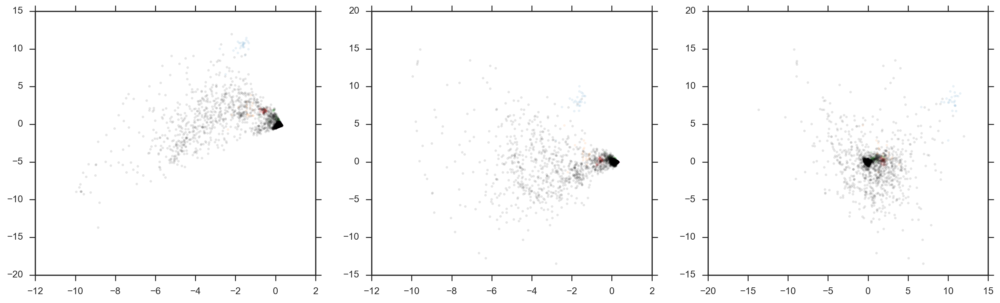

In [319]:
m_hd = HDBSCAN(min_cluster_size=15, min_samples=5, core_dist_n_jobs=8)
m_hd.fit(X_pca20)
_plot_reduced_clustering(X_pca20, m_hd.labels_)
_show_info_clustering(X_pca20, m_hd.labels_)

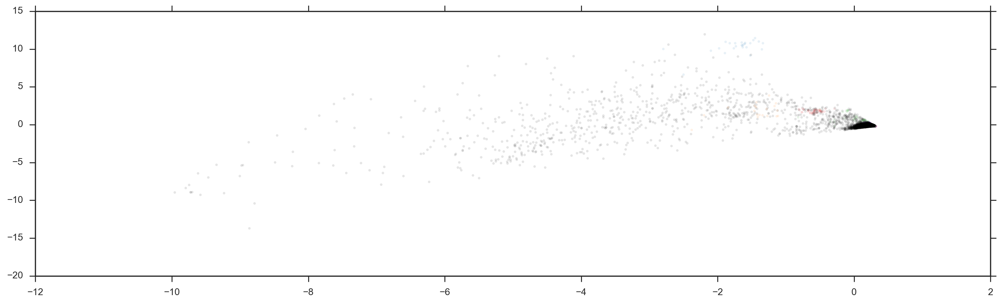

In [320]:
_plot_reduced_clustering(X_pca, m_hd.labels_)

Estimated number of clusters: 12
                -1     10   8    9    3    7    1    0    4    2    5    6 
Label members  6045  5095  722  352   48   44   29   28   19   14   13   10


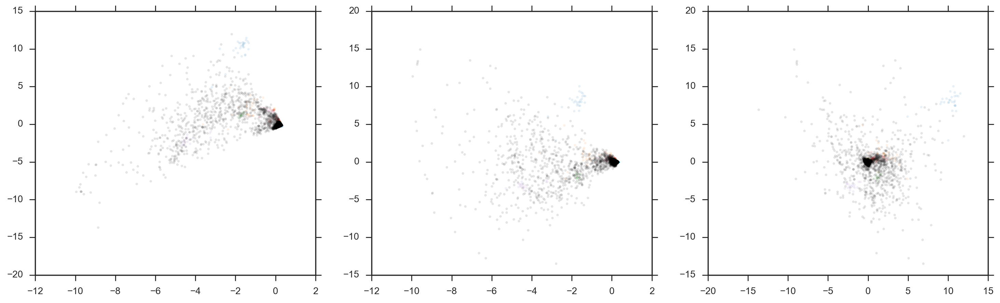

In [321]:
m_hd = HDBSCAN(min_cluster_size=10, min_samples=3, core_dist_n_jobs=8)
m_hd.fit(X_pca20)
_plot_reduced_clustering(X_pca20, m_hd.labels_)
_show_info_clustering(X_pca20, m_hd.labels_)

Estimated number of clusters: 8
                  -1    4    6    5   2   3   0   1
Label members  11023  692  352  299  18  14  11  10


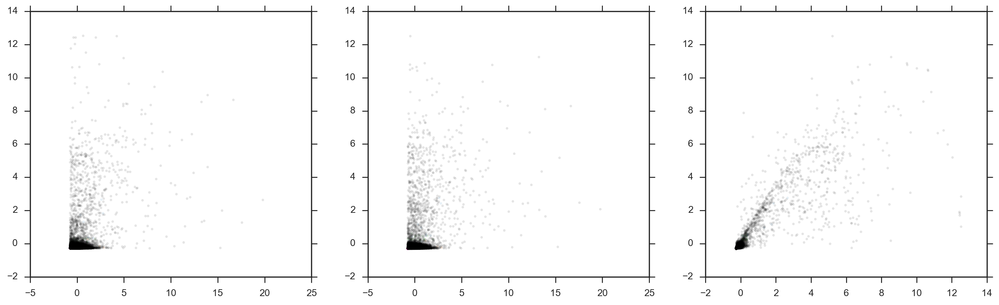

In [322]:
m_hd = HDBSCAN(min_cluster_size=10, min_samples=3, core_dist_n_jobs=8)
m_hd.fit(X_std)
_plot_reduced_clustering(X_std, m_hd.labels_)
_show_info_clustering(X_std, m_hd.labels_, labels_true=None)

Estimated number of clusters: 23
                 -1    20   12   21   10   8    0    7    17   4  ...    11   9    5    3    2    13   1    16   15  \
Label members  10475  658  563  352   64   34   32   27   20   20 ...    15   14   13   13   13   12   11   11   10   

                19  
Label members   10  

[1 rows x 23 columns]


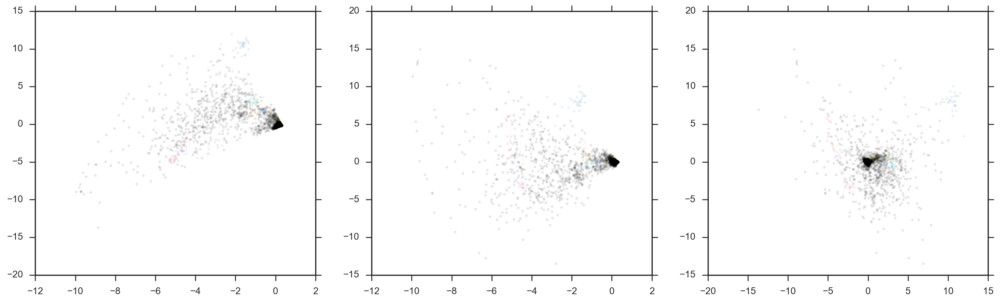

In [323]:
m_hd = HDBSCAN(min_cluster_size=10, min_samples=3, core_dist_n_jobs=8)
m_hd.fit(X)
_plot_reduced_clustering(X_pca3, m_hd.labels_)
_show_info_clustering(X, m_hd.labels_)

In [324]:
m_pca50 = PCA(n_components=50, whiten=False)
X_pca50 = m_pca50.fit_transform(X)
X_pca50.shape

(12419, 50)

Estimated number of clusters: 36
                -1     34   24   31   21   18   0    16   5    28 ...    22   7    10   27   1    13   30   11   17  \
Label members  9104  1884  703  352   49   34   29   25   18   17 ...     7    6    6    6    6    6    6    5    5   

                15  
Label members    5  

[1 rows x 36 columns]


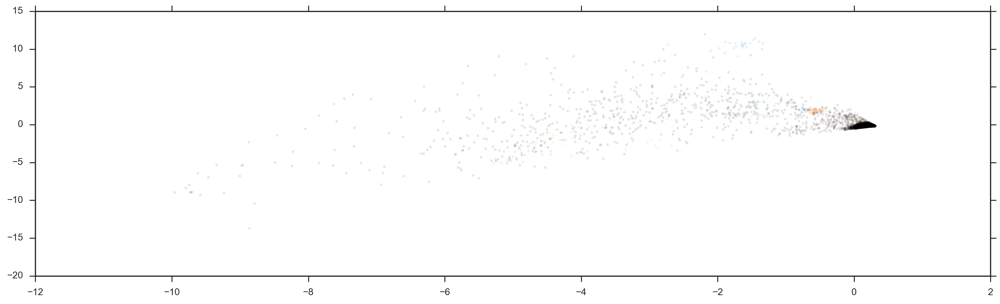

In [325]:
m_hd = HDBSCAN(min_cluster_size=5, min_samples=5, core_dist_n_jobs=8)
m_hd.fit(X_pca50)
_plot_reduced_clustering(X_pca, m_hd.labels_)
_show_info_clustering(X_pca50, m_hd.labels_)

(301, 12419) (90, 12419)


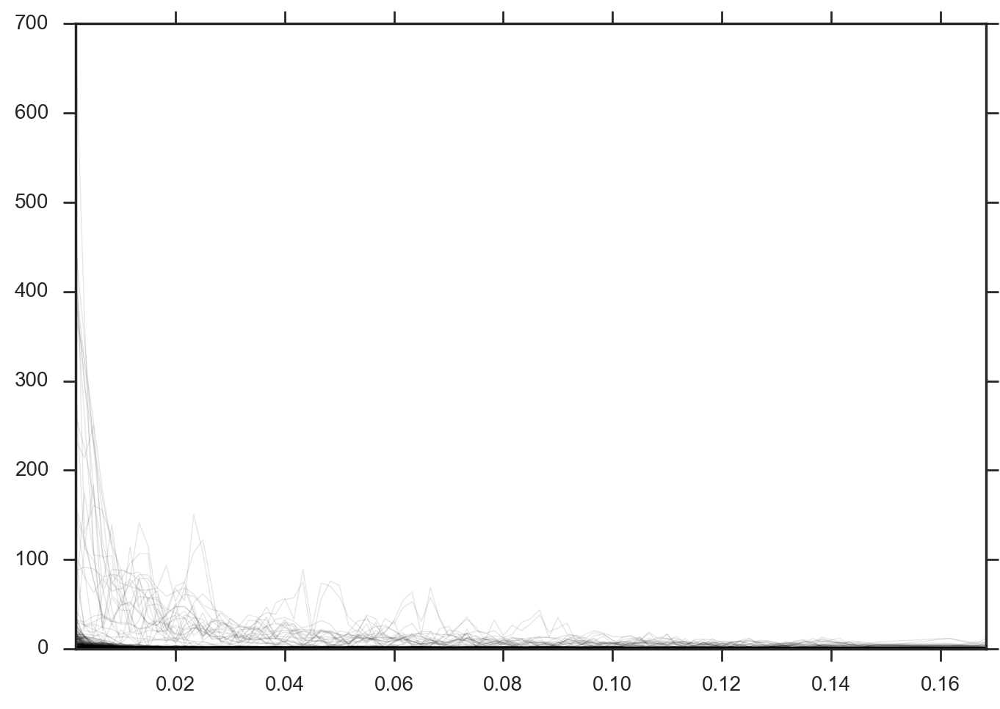

In [339]:
std_freqs = results_FFT.std(axis=1)
cond_freq = std_freqs > .02 * std_freqs.max()

print(results_FFT.shape, results_FFT[cond_freq].shape)
results_FFT[cond_freq][results_FFT.columns[:500]].plot(lw=.5, legend='', alpha=.1, c='k')


,2016-08-12 10:46:25+02:00,2016-08-12 10:51:25+02:00,2016-08-12 10:56:25+02:00,2016-08-12 11:01:25+02:00,2016-08-12 11:06:25+02:00,2016-08-12 11:11:25+02:00,2016-08-12 11:16:25+02:00,2016-08-12 11:21:25+02:00,2016-08-12 11:26:25+02:00,2016-08-12 11:31:25+02:00,...,2016-09-24 12:51:25+02:00,2016-09-24 12:56:25+02:00,2016-09-24 13:01:25+02:00,2016-09-24 13:06:25+02:00,2016-09-24 13:11:25+02:00,2016-09-24 13:16:25+02:00,2016-09-24 13:21:25+02:00,2016-09-24 13:26:25+02:00,2016-09-24 13:31:25+02:00,2016-09-24 13:36:25+02:00
0.001667,NaN,NaN,7.958858,5.965485,3.142976,1.779582,1.893648,5.156430,8.226401,88.131238,...,13.799584,12.491794,12.011036,7.711722,5.476074,5.292525,2.905432,2.174091,NaN,NaN
0.003333,NaN,NaN,10.665034,5.776941,2.654719,1.723970,1.974101,2.982918,4.544849,65.017046,...,10.808747,10.723249,8.495044,6.960542,4.609065,3.325466,2.190567,2.027311,NaN,NaN
0.005000,NaN,NaN,9.575294,4.386593,1.505445,1.217033,1.386776,2.185377,2.642086,38.037310,...,6.602973,6.649120,5.129406,4.791851,3.049612,1.487983,1.227600,1.260931,NaN,NaN
0.006667,NaN,NaN,5.037697,4.178422,1.456658,1.162657,1.767942,2.436017,2.858761,16.057558,...,5.552399,4.802324,4.247968,2.843850,1.813848,1.339498,1.101067,0.791388,NaN,NaN
0.008333,NaN,NaN,9.406665,3.848063,1.375551,0.974157,1.166933,1.173606,1.901004,7.071875,...,5.521655,5.708414,4.453066,3.052491,2.712937,1.212388,0.642748,0.636089,NaN,NaN
0.010000,NaN,NaN,5.978772,3.613077,1.018020,0.826091,1.075183,1.516527,1.847732,12.892125,...,1.777289,1.924356,1.810745,1.429390,1.065312,0.795618,0.445990,0.388413,NaN,NaN
0.011667,NaN,NaN,6.967742,3.670252,1.142791,0.838049,0.825006,1.122319,1.079265,15.339367,...,3.463591,2.793766,2.184437,1.336144,0.852132,0.387996,0.593872,0.654977,NaN,NaN
0.013333,NaN,NaN,7.553818,3.338696,1.117070,0.803210,0.655303,0.846816,1.186336,17.746884,...,2.174288,2.247832,1.626539,1.486089,1.039735,0.960381,0.730498,0.618252,NaN,NaN
0.015000,NaN,NaN,3.293248,3.109271,1.214097,0.918960,0.714309,1.108080,1.491023,17.801479,...,2.260157,2.126710,1.745587,1.092069,0.663106,0.799490,0.898885,0.762878,NaN,NaN
0.016667,NaN,NaN,6.520104,2.691084,0.902546,0.884451,0.712375,0.876102,1.182946,14.668826,...,1.542201,1.183071,1.059346,0.875243,0.680862,0.768536,0.851240,0.709851,NaN,NaN


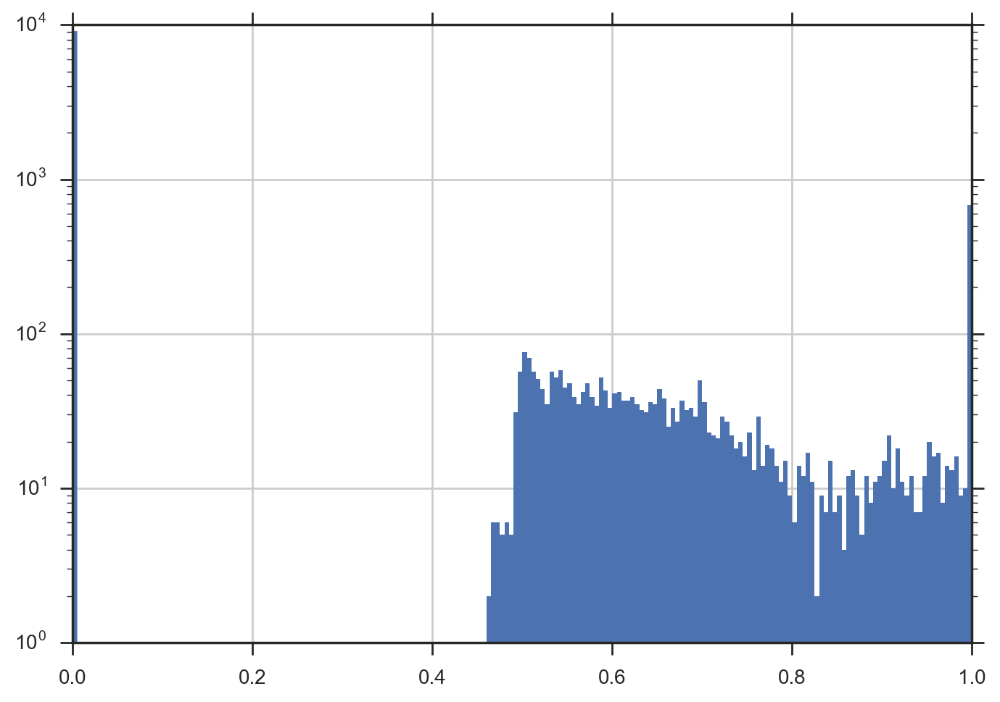

In [90]:
pd.Series(m_hd.probabilities_).hist(bins=200, lw=0, log=True)

In [277]:
pd_ts_df = ax_t.xaxis.get_major_formatter()
pd_ts_df.

True

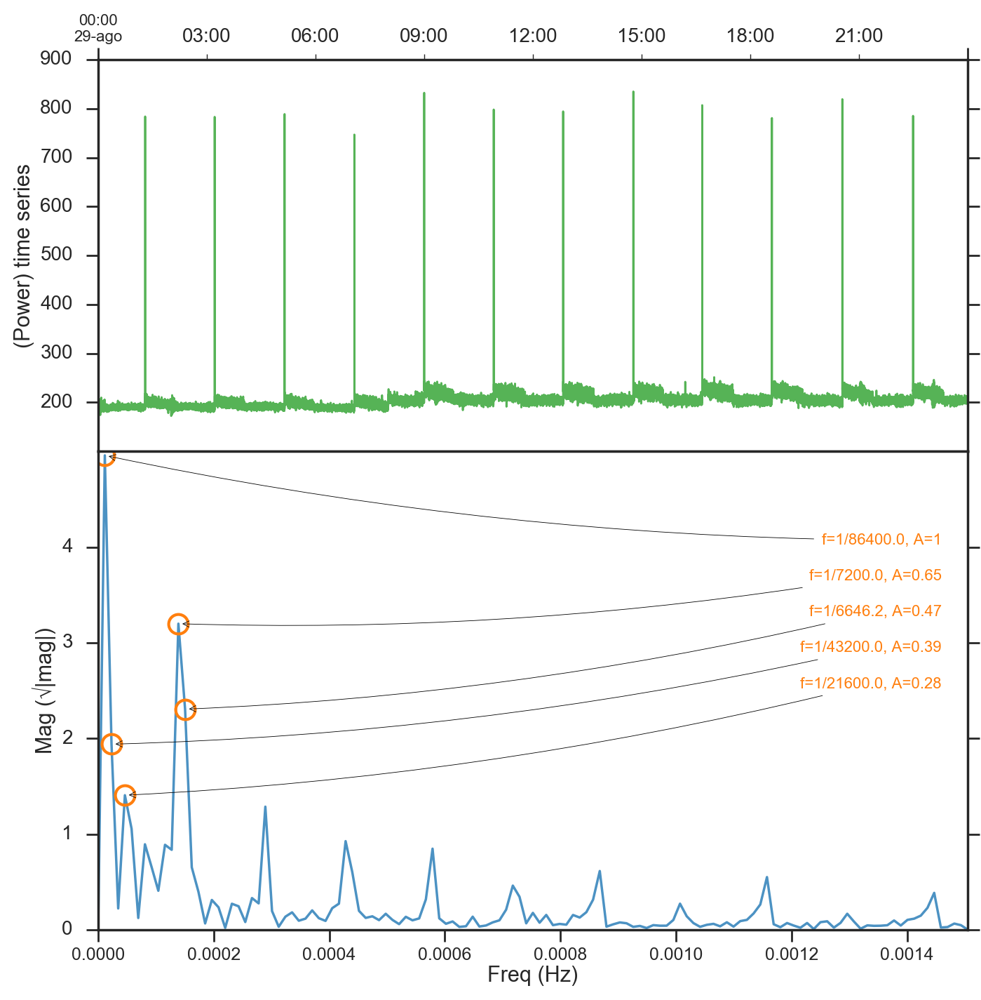

In [267]:
freqs1, mags1 = process_fft(power_standby.power, with_freq=True)
freqs2, mags2 = process_fft(power_day14.power, with_freq=True)

ax_t, ax_f = plot_tt_fft(power_standby.power, freqs1, mags1)
ax_t
#_plot_tt_fft(tt, x, df_fft, best_fft, log_mag=log_mag, figsize=figsize)


In [191]:
np.concatenate?

In [86]:
# Divide results_FFT de cluster=k en intervalos consecutivos:
def _group_intervals(df, step=pd.Timedelta('5min')):
    groups = []
    t_ant = df.index[0]
    start = df.index[0]
    end = start + step
    for t in df.index[1:]:
        if t - end > 1.1 * step:
            groups.append(df.loc[start:end])
            start, end = t, t + step
        else:
            end += step
    print_info('LEN={}, GROUPS={}'.format(len(df), len(groups)))
    return groups


g_nulos = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 31])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g_nulos];

LEN=352, GROUPS=9
(14, 299), de 2016-08-13 21:01:25+02:00 a 2016-08-13 22:06:25+02:00
(2, 299), de 2016-08-16 19:11:25+02:00 a 2016-08-16 19:16:25+02:00
(25, 299), de 2016-08-16 22:06:25+02:00 a 2016-08-17 00:06:25+02:00
(4, 299), de 2016-08-17 14:21:25+02:00 a 2016-08-17 14:36:25+02:00
(1, 299), de 2016-08-17 20:31:25+02:00 a 2016-08-17 20:31:25+02:00
(3, 299), de 2016-08-17 20:46:25+02:00 a 2016-08-17 20:56:25+02:00
(4, 299), de 2016-08-18 12:21:25+02:00 a 2016-08-18 12:36:25+02:00
(2, 299), de 2016-08-19 00:21:25+02:00 a 2016-08-19 00:26:25+02:00
(276, 299), de 2016-08-31 00:01:25+02:00 a 2016-08-31 22:56:25+02:00


In [84]:
def plot_muestra_tt(alldata, clustered_intervals, idx_samples=(0, 1, 2, 3, 4, 5), offset=pd.Timedelta('10min')):
    nr = len(idx_samples) // 3
    if len(idx_samples) % 3 != 0:
        nr += 1
    fig = plt.figure(figsize=(18, 5*nr))
    for i, df_fft in enumerate([clustered_intervals[idx] for idx in idx_samples]):
        ax = fig.add_subplot(nr, 3, i+1)
        t0, tf = df_fft.index[0], df_fft.index[-1]
        df_tt = homog_power.loc[t0:tf+offset]
        df_tt.plot(ax=ax, lw=1, color=tableau20[4], alpha=.8, legend='')
        ax.xaxis.tick_bottom()
        plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, ha='center')
        ax.xaxis.set_tick_params(labelsize=8, pad=2)
        ax.grid('on', axis='x')
        ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M'))
        ax.xaxis.set_major_locator(mpd.MinuteLocator(range(0, 60, 5)))
        ax.xaxis.set_minor_locator(mpd.MinuteLocator())
        ax.annotate('{:%d-%b}, (cont:{})'.format(t0, len(df_fft)), (.98, .98), xycoords='axes fraction', 
                    fontsize=8, color=tableau20[2], va='top', ha='right')



LEN=49, GROUPS=28
(2, 299), de 2016-08-12 14:01:25+02:00 a 2016-08-12 14:06:25+02:00
(1, 299), de 2016-08-15 11:41:25+02:00 a 2016-08-15 11:41:25+02:00
(2, 299), de 2016-08-15 20:36:25+02:00 a 2016-08-15 20:41:25+02:00
(2, 299), de 2016-08-16 11:51:25+02:00 a 2016-08-16 11:56:25+02:00
(2, 299), de 2016-08-17 11:06:25+02:00 a 2016-08-17 11:11:25+02:00
(1, 299), de 2016-08-17 15:36:25+02:00 a 2016-08-17 15:36:25+02:00
(2, 299), de 2016-08-17 18:56:25+02:00 a 2016-08-17 19:01:25+02:00
(1, 299), de 2016-08-17 19:31:25+02:00 a 2016-08-17 19:31:25+02:00
(2, 299), de 2016-08-19 12:01:25+02:00 a 2016-08-19 12:06:25+02:00
(2, 299), de 2016-08-19 18:01:25+02:00 a 2016-08-19 18:06:25+02:00
(2, 299), de 2016-08-19 19:41:25+02:00 a 2016-08-19 19:46:25+02:00
(2, 299), de 2016-08-24 14:26:25+02:00 a 2016-08-24 14:31:25+02:00
(2, 299), de 2016-08-24 17:31:25+02:00 a 2016-08-24 17:36:25+02:00
(2, 299), de 2016-08-24 18:41:25+02:00 a 2016-08-24 18:46:25+02:00
(2, 299), de 2016-08-25 14:31:25+02:00 a 201

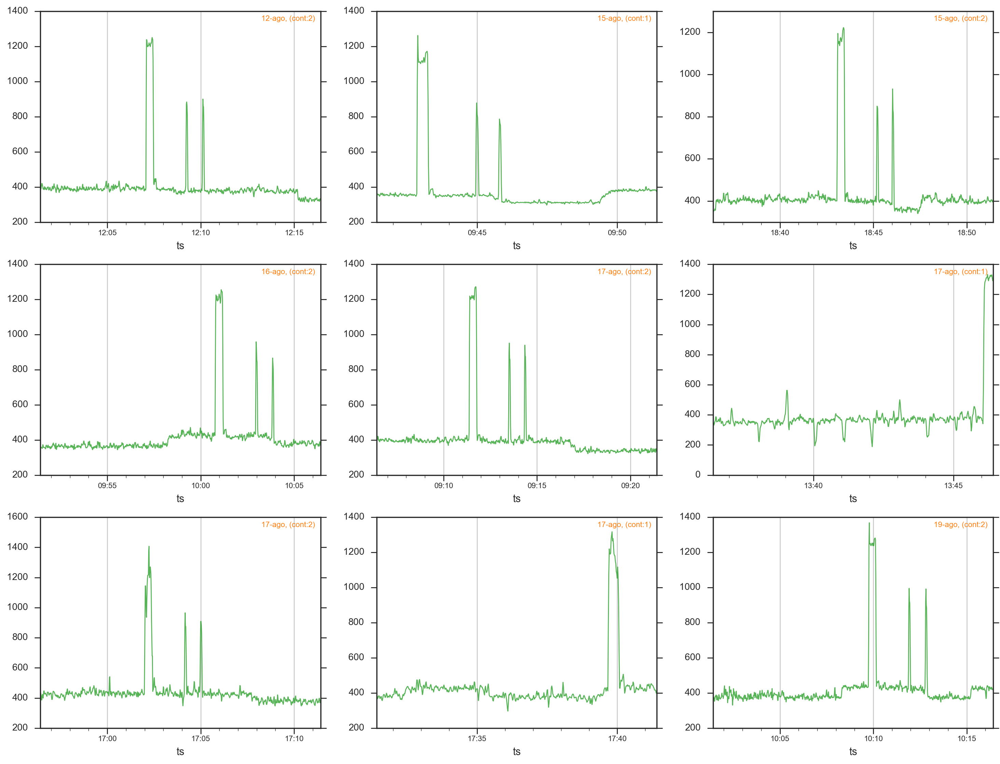

In [87]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 20])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
plot_muestra_tt(homog_power, g, (0, 1, 2, 3, 4, 5, 6, 7, 8));

LEN=34, GROUPS=6
(3, 299), de 2016-08-24 09:11:25+02:00 a 2016-08-24 09:21:25+02:00
(5, 299), de 2016-08-24 09:36:25+02:00 a 2016-08-24 09:56:25+02:00
(11, 299), de 2016-09-04 14:36:25+02:00 a 2016-09-04 15:26:25+02:00
(6, 299), de 2016-09-05 09:46:25+02:00 a 2016-09-05 10:11:25+02:00
(1, 299), de 2016-09-11 14:46:25+02:00 a 2016-09-11 14:46:25+02:00
(3, 299), de 2016-09-19 13:06:25+02:00 a 2016-09-19 13:16:25+02:00


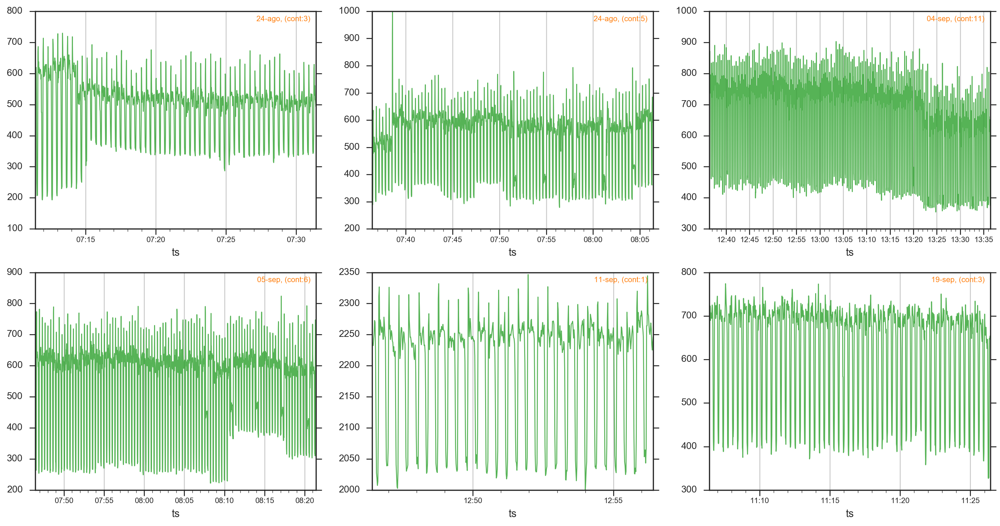

In [88]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 17])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
plot_muestra_tt(homog_power, g, (0, 1, 2, 3, 4, 5));

LEN=25, GROUPS=5
(7, 299), de 2016-08-24 10:11:25+02:00 a 2016-08-24 10:41:25+02:00
(3, 299), de 2016-09-04 15:41:25+02:00 a 2016-09-04 15:51:25+02:00
(7, 299), de 2016-09-05 10:31:25+02:00 a 2016-09-05 11:01:25+02:00
(3, 299), de 2016-09-11 16:26:25+02:00 a 2016-09-11 16:41:25+02:00
(4, 299), de 2016-09-19 14:11:25+02:00 a 2016-09-19 14:26:25+02:00


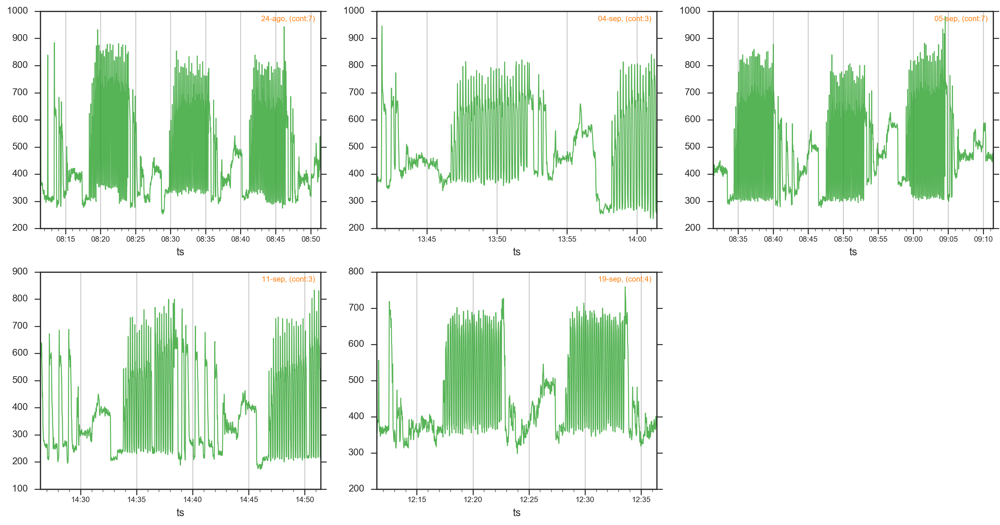

In [94]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 15])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
plot_muestra_tt(homog_power, g, (0, 1, 2, 3, 4));

LEN=5, GROUPS=4
(1, 299), de 2016-08-23 12:16:25+02:00 a 2016-08-23 12:16:25+02:00
(1, 299), de 2016-09-03 16:41:25+02:00 a 2016-09-03 16:41:25+02:00
(1, 299), de 2016-09-17 21:31:25+02:00 a 2016-09-17 21:31:25+02:00
(1, 299), de 2016-09-20 15:41:25+02:00 a 2016-09-20 15:41:25+02:00


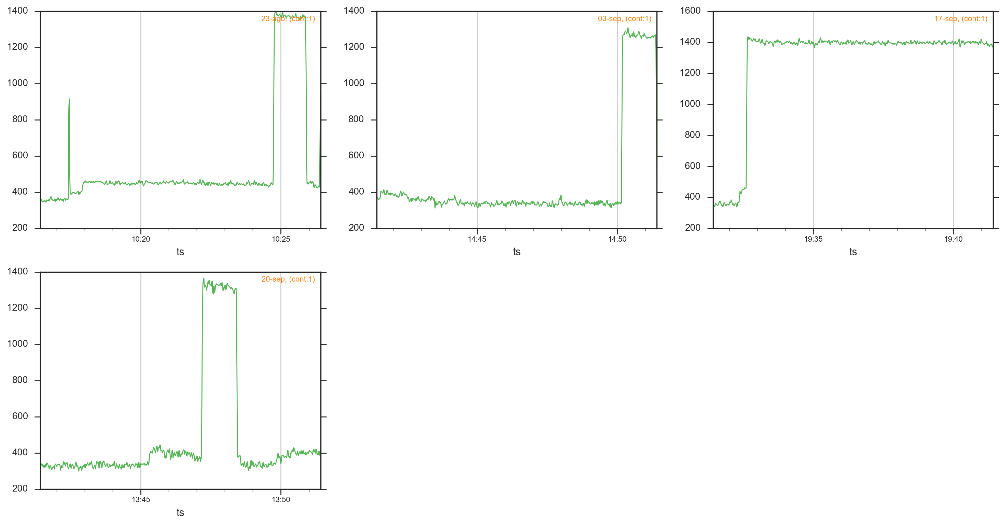

In [97]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 16])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
plot_muestra_tt(homog_power, g, (0, 1, 2, 3));

LEN=6, GROUPS=2
(2, 299), de 2016-08-14 15:31:25+02:00 a 2016-08-14 15:36:25+02:00
(2, 299), de 2016-08-23 14:56:25+02:00 a 2016-08-23 15:01:25+02:00


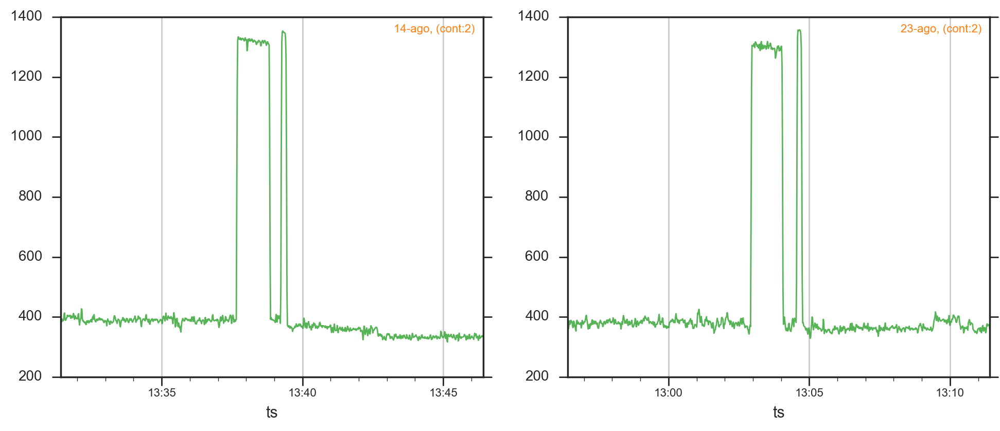

In [101]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 12])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
plot_muestra_tt(homog_power, g, (0, 1));

LEN=16, GROUPS=7
(4, 299), de 2016-08-15 12:41:25+02:00 a 2016-08-15 13:01:25+02:00
(1, 299), de 2016-08-15 13:26:25+02:00 a 2016-08-15 13:26:25+02:00
(1, 299), de 2016-08-23 13:01:25+02:00 a 2016-08-23 13:01:25+02:00
(1, 299), de 2016-08-23 13:16:25+02:00 a 2016-08-23 13:16:25+02:00
(3, 299), de 2016-08-23 13:41:25+02:00 a 2016-08-23 13:51:25+02:00
(1, 299), de 2016-09-02 13:51:25+02:00 a 2016-09-02 13:51:25+02:00
(1, 299), de 2016-09-12 15:06:25+02:00 a 2016-09-12 15:06:25+02:00


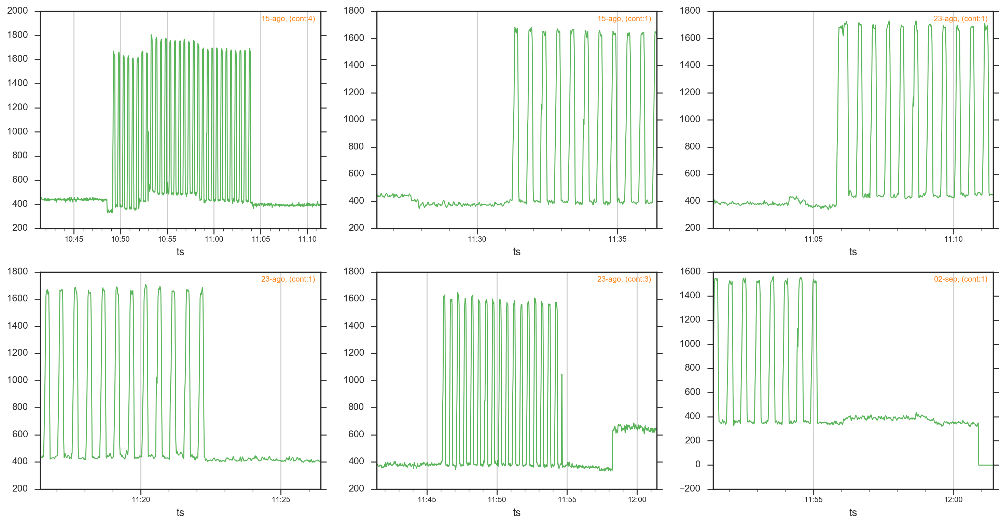

In [107]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 2])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
plot_muestra_tt(homog_power, g, (0, 1, 2, 3, 4, 5));

LEN=7, GROUPS=1
(3, 299), de 2016-09-19 10:31:25+02:00 a 2016-09-19 10:41:25+02:00


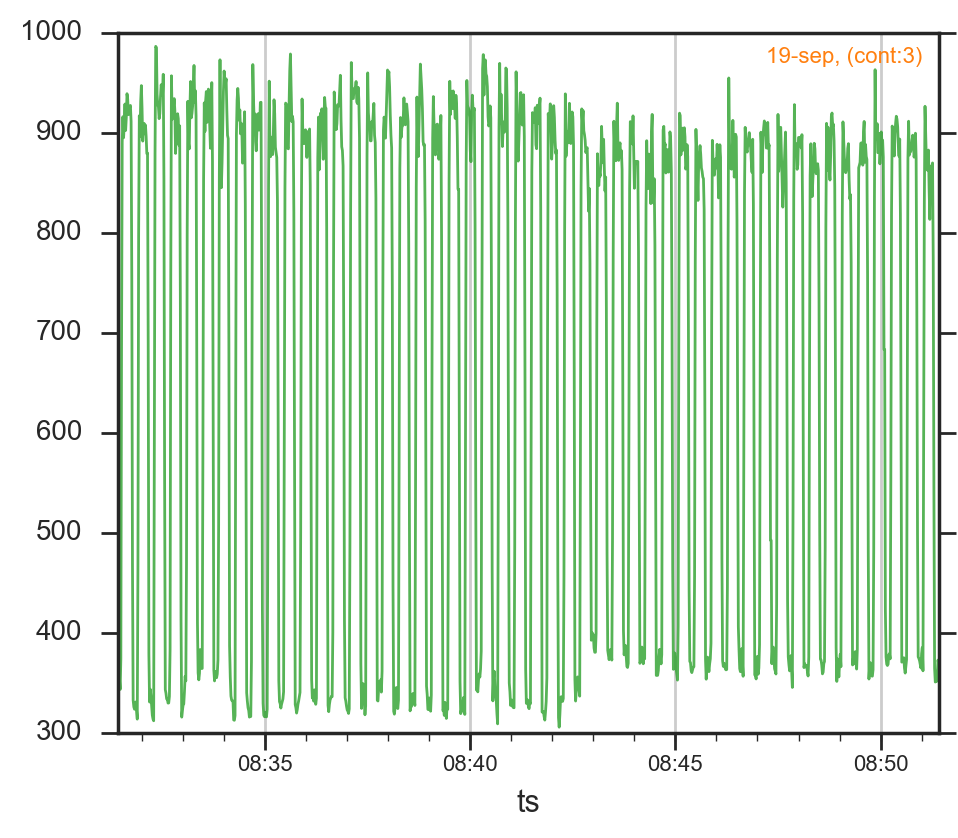

In [110]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 3])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
plot_muestra_tt(homog_power, g, [0]);

In [116]:
g = _group_intervals(results_FFT.T.loc[m_hd.labels_ == 30])
[print_red('{}, de {} a {}'.format(df.shape, df.index[0], df.index[-1])) for df in g]
#plot_muestra_tt(homog_power, g, [0, 1, 2, 3, 4]);

LEN=6, GROUPS=3
(1, 299), de 2016-09-13 03:06:25+02:00 a 2016-09-13 03:06:25+02:00
(2, 299), de 2016-09-13 11:11:25+02:00 a 2016-09-13 11:16:25+02:00
(1, 299), de 2016-09-18 04:21:25+02:00 a 2016-09-18 04:21:25+02:00


[None, None, None]

In [143]:
grupos = [_group_intervals(results_FFT.T.loc[m_hd.labels_ == k]) for k in set(m_hd.labels_)]
grupos[0][0]

LEN=29, GROUPS=6
LEN=7, GROUPS=4
LEN=16, GROUPS=7
LEN=7, GROUPS=1
LEN=7, GROUPS=5
LEN=17, GROUPS=13
LEN=10, GROUPS=9
LEN=6, GROUPS=1
LEN=16, GROUPS=9
LEN=7, GROUPS=5
LEN=6, GROUPS=0
LEN=7, GROUPS=5
LEN=6, GROUPS=2
LEN=7, GROUPS=5
LEN=6, GROUPS=4
LEN=25, GROUPS=5
LEN=5, GROUPS=4
LEN=34, GROUPS=6
LEN=7, GROUPS=4
LEN=7, GROUPS=6
LEN=49, GROUPS=28
LEN=7, GROUPS=6
LEN=5, GROUPS=3
LEN=7, GROUPS=3
LEN=703, GROUPS=386
LEN=9, GROUPS=8
LEN=8, GROUPS=7
LEN=5, GROUPS=4
LEN=16, GROUPS=14
LEN=8, GROUPS=7
LEN=6, GROUPS=3
LEN=352, GROUPS=9
LEN=13, GROUPS=10
LEN=1885, GROUPS=430
LEN=7, GROUPS=5
LEN=9107, GROUPS=663


,0.00166666666667,0.00333333333333,0.005,0.00666666666667,0.00833333333333,0.01,0.0116666666667,0.0133333333333,0.015,0.0166666666667,...,0.483333333333,0.485,0.486666666667,0.488333333333,0.49,0.491666666667,0.493333333333,0.495,0.496666666667,0.498333333333
2016-08-16 13:31:25+02:00,49.746365,17.635344,11.440035,13.783252,28.941254,76.936813,266.548248,239.993362,87.682877,70.052200,...,1.889479,1.310070,0.403492,0.939250,0.809077,2.060910,1.733309,0.280271,1.644291,2.126859
2016-08-16 13:36:25+02:00,50.790249,26.568062,40.019585,34.800629,59.302490,92.890160,294.288208,223.066727,83.048897,42.668240,...,1.687028,2.613954,2.660320,0.847003,1.448538,1.335145,2.242321,0.917421,2.797906,1.245056
2016-08-16 13:41:25+02:00,31.358440,15.753420,18.051678,28.217567,40.372501,75.789658,266.689117,244.285843,94.989357,58.007263,...,1.791323,0.286347,2.315764,1.505536,0.858479,1.781540,1.237080,0.922944,1.566764,1.803840
2016-08-16 13:46:25+02:00,14.005749,14.992897,20.063854,35.088631,52.746693,83.634117,284.011627,219.301666,74.715973,36.227924,...,0.462845,0.335131,0.444150,0.523989,0.802621,0.276573,1.106143,0.538222,0.699864,0.264173
2016-08-16 13:51:25+02:00,29.387775,54.298721,12.829306,56.636486,30.748795,115.065361,236.188568,203.646210,98.070847,32.506908,...,1.109606,1.131581,0.941102,0.961426,1.408592,1.070258,1.970464,1.252154,1.522210,0.716903
2016-08-16 13:56:25+02:00,53.839409,38.913010,31.958479,53.333107,49.253082,79.440796,276.888977,210.432297,66.440445,40.705254,...,0.287785,0.614017,0.477474,0.815441,0.460675,0.689673,0.294430,0.563319,0.783886,0.550468
2016-08-16 14:01:25+02:00,24.529593,37.795292,35.822327,49.347195,61.018932,93.306534,278.194489,213.407822,77.962852,44.361565,...,1.299446,1.147755,0.990790,1.478405,0.635525,1.331867,1.458614,1.566406,1.223753,1.302908


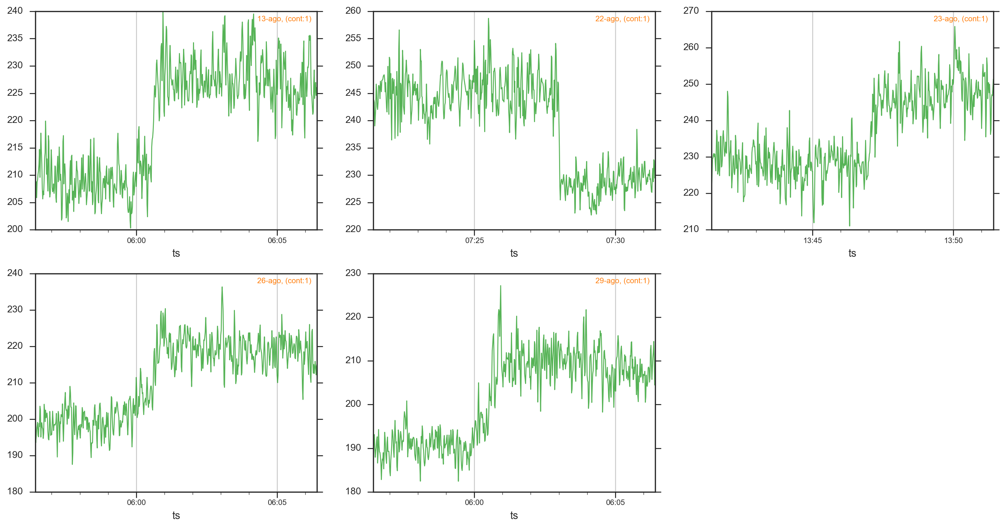

In [124]:
plot_muestra_tt(homog_power, grupos[-7], [0, 1, 2, 3, 4]);

Bbox([[0.6, 0.6], [0.8999999999999999, 0.8999999999999999]])

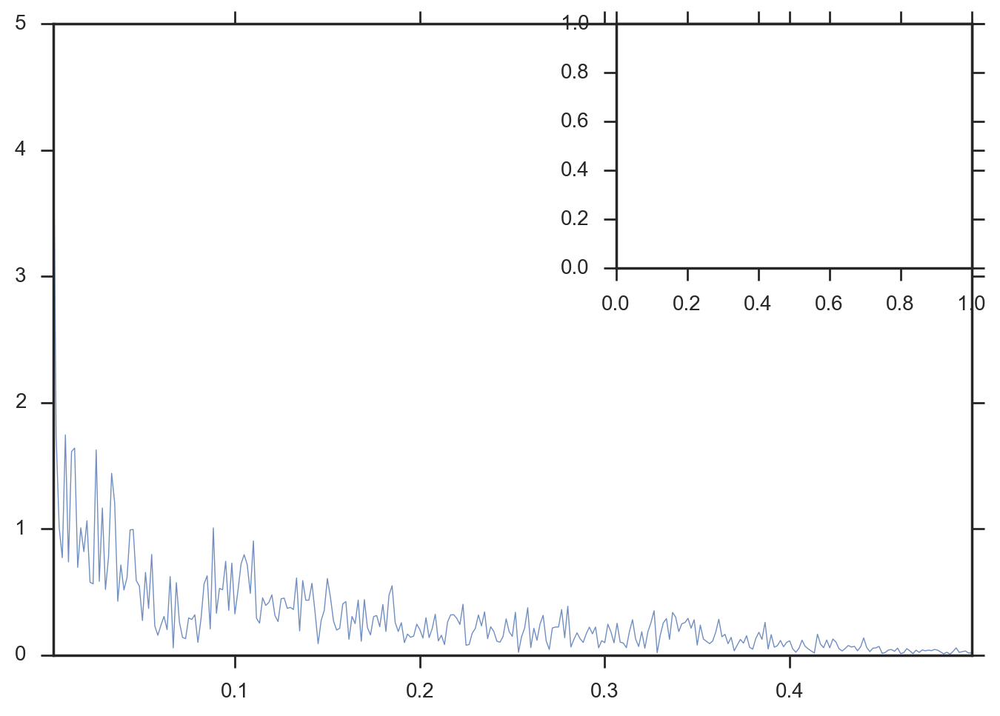

In [140]:
ax = results_FFT.T.iloc[1000].plot(lw=.5, alpha=.8)
ax2 = plt.axes([.6, .6, .3, .3])
#ax2 = plt.subplot(position=[[0.125, 0.3], [0.9, 0.7]])
ax2.get_position()

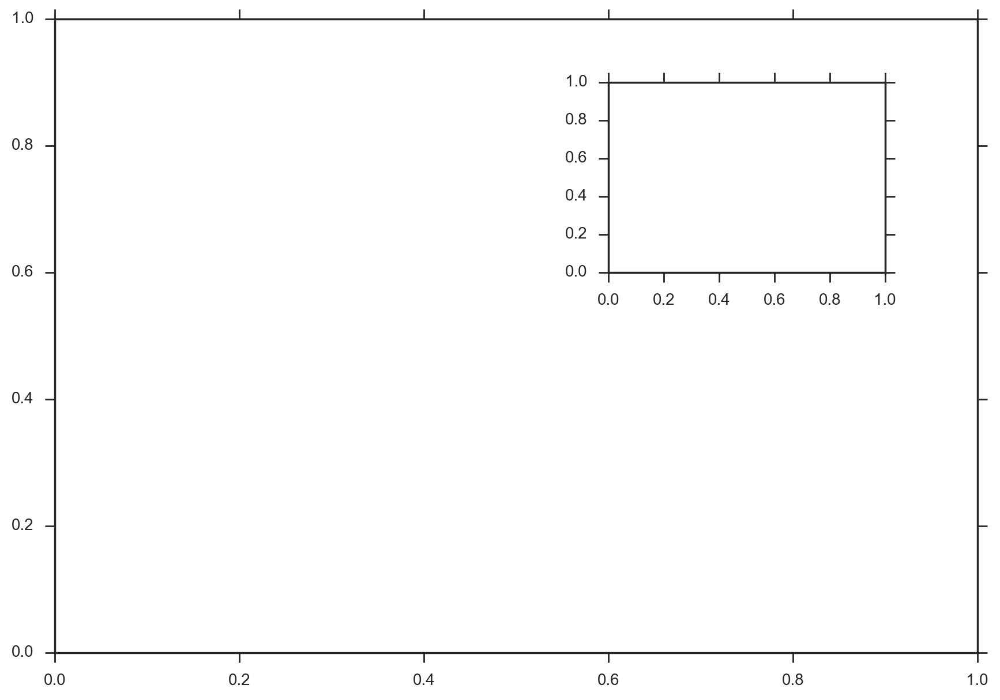

In [138]:
ax1 = plt.axes([0, 0, 1, 1])
ax2 = plt.axes([.6, .6, .3, .3])

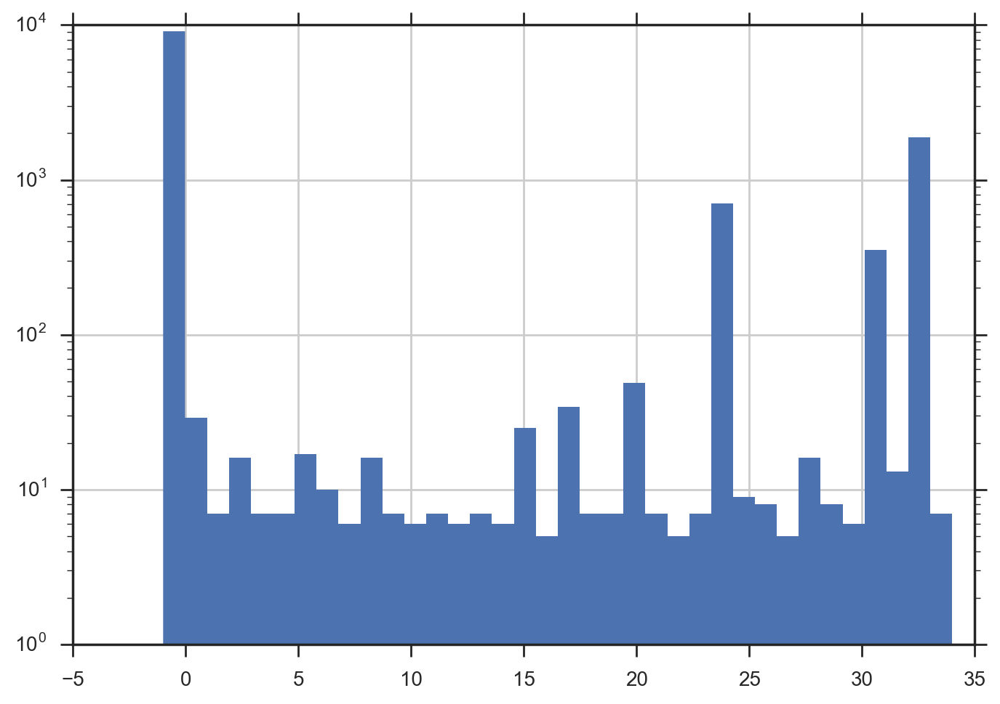

In [92]:
pd.Series(m_hd.labels_).hist(bins=len(set(m_hd.labels_)), lw=0, log=True)

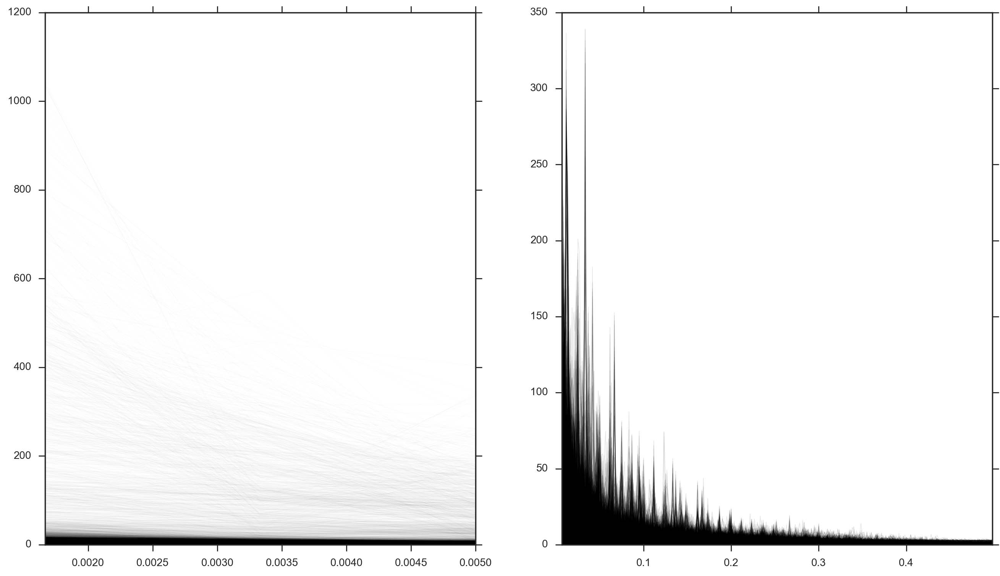

In [21]:
plt.figure(figsize=(16, 9))
ax = plt.subplot(121)
results_FFT.loc[:.006].plot(ax=ax, lw=.5, color='k', alpha=.01)
plt.legend([])

ax = plt.subplot(122)
results_FFT.loc[.006:].plot(ax=ax, lw=.5, color='k', alpha=.1)
plt.legend([])

In [22]:
k = 14
#m_km = KMeans(k, n_jobs=-1).fit(X)
#m_km

(0, 150)

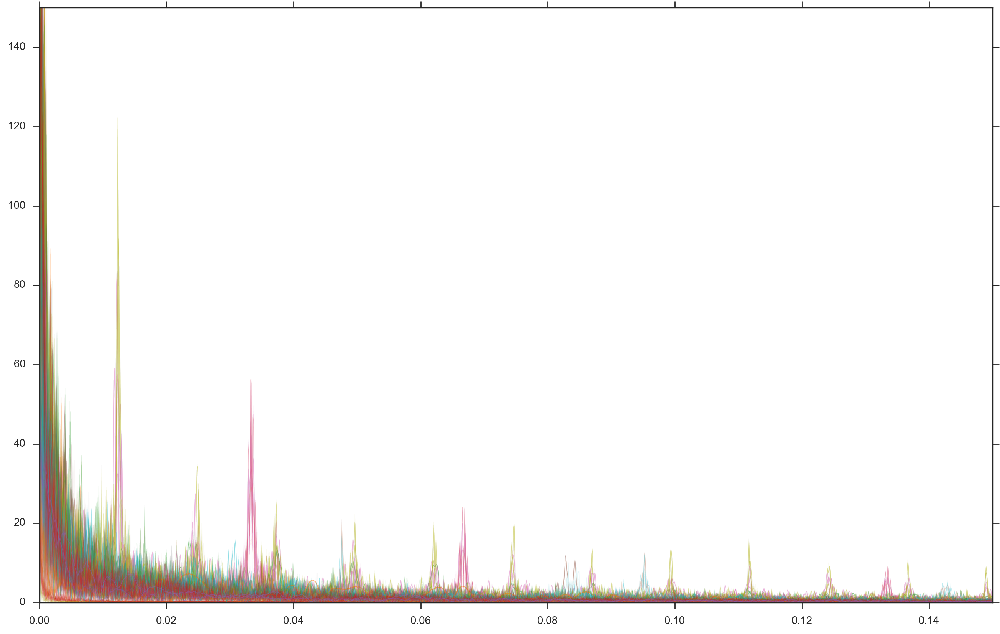

In [69]:

#df_fft_all.T
#pd.Series(m_km.labels_).value_counts()
plt.figure(figsize=FS)
ax = plt.subplot(111)
for ki in range(k):
    df_fft_all.T.iloc[m_km.labels_ == ki].iloc[:50].T.plot(ax=ax, lw=.5, c=next(cm), alpha=.05, legend='')
plt.xlim(0, .15)
plt.ylim(0, 150)

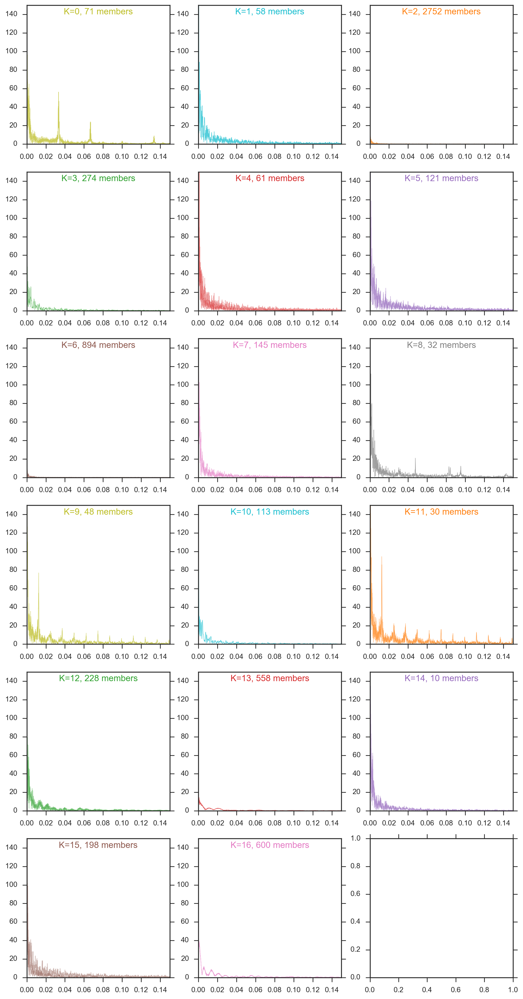

In [80]:
f, axes = plt.subplots(6, 3, figsize=(12, 24))
for ki, ax in zip(range(k), axes.ravel()):
    #ax = plt.subplot(6, 3, k+1)
    sub_data = df_fft_all.T.iloc[m_km.labels_ == ki]
    n = len(sub_data)
    color = next(cm)
    #sub_data.T.plot(ax=ax, lw=.5, c=color, alpha=1.2/n, legend='')
    sub_data.iloc[:2].T.plot(ax=ax, lw=.5, c=color, alpha=.5, legend='')
    ax.set_xlim((0, .15))
    ax.set_ylim((0, 150))
    ax.grid('on', 'x')
    ax.xaxis.tick_bottom()
    ax.annotate('K={}, {} members'.format(ki, n), (.5, .98), xycoords='axes fraction', 
                color=color, fontsize=12, va='top', ha='center')
plt.show()

In [83]:
m_hd = HDBSCAN().fit(X)
m_hd

HDBSCAN(algorithm='best', allow_single_cluster=False, alpha=1.0,
    approx_min_span_tree=True, core_dist_n_jobs=4, gen_min_span_tree=False,
    leaf_size=40, memory=Memory(cachedir=None), metric='euclidean',
    min_cluster_size=5, min_samples=None, p=None)

In [23]:
#pd.Series(m_hd.labels_).value_counts(), m_hd.labels_.max()

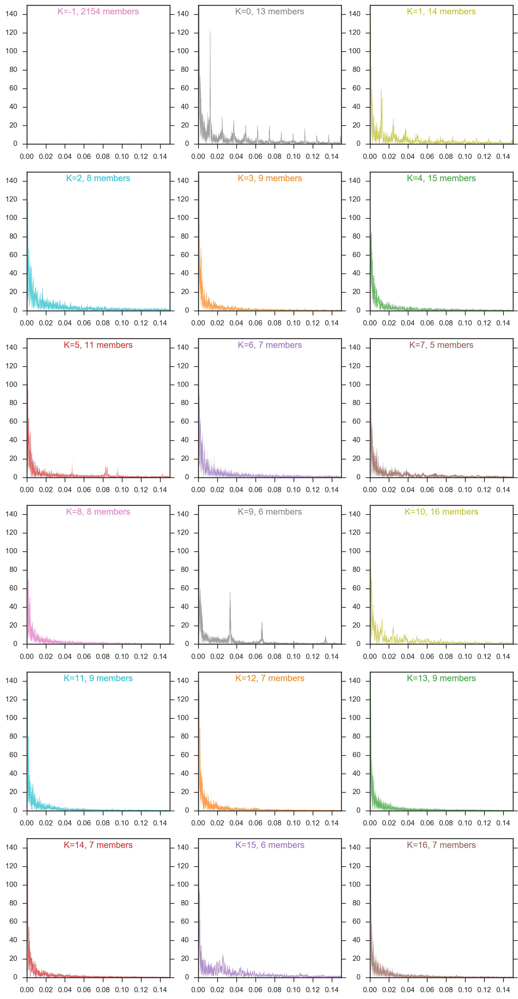

In [89]:
f, axes = plt.subplots(6, 3, figsize=(12, 24))
for ki, ax in zip(range(-1, k), axes.ravel()):
    #ax = plt.subplot(6, 3, k+1)
    sub_data = df_fft_all.T.iloc[m_hd.labels_ == ki]
    n = len(sub_data)
    color = next(cm)
    sub_data.T.plot(ax=ax, lw=.5, c=color, alpha=1.2/n, legend='')
    #sub_data.iloc[:2].T.plot(ax=ax, lw=.5, c=color, alpha=.5, legend='')
    ax.set_xlim((0, .15))
    ax.set_ylim((0, 150))
    ax.grid('on', 'x')
    ax.xaxis.tick_bottom()
    ax.annotate('K={}, {} members'.format(ki, n), (.5, .98), xycoords='axes fraction', 
                color=color, fontsize=12, va='top', ha='center')
plt.show()

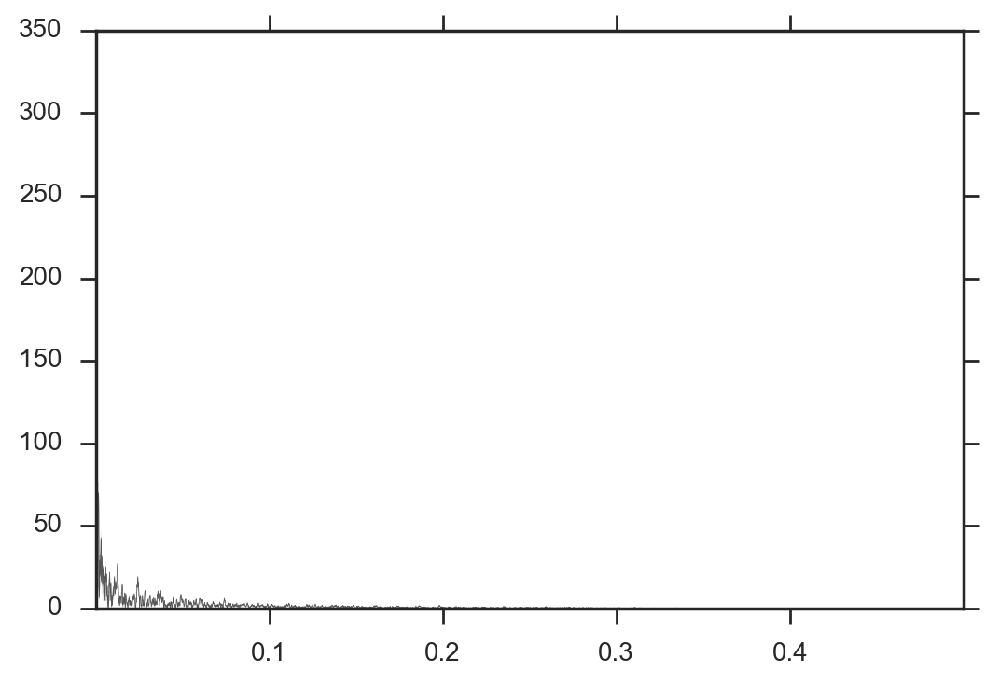

In [113]:
ki = 10
sub_data = df_fft_all.T.iloc[m_hd.labels_ == ki]
sub_data.T.plot(c='k', alpha=1/len(sub_data), lw=.25, legend='')

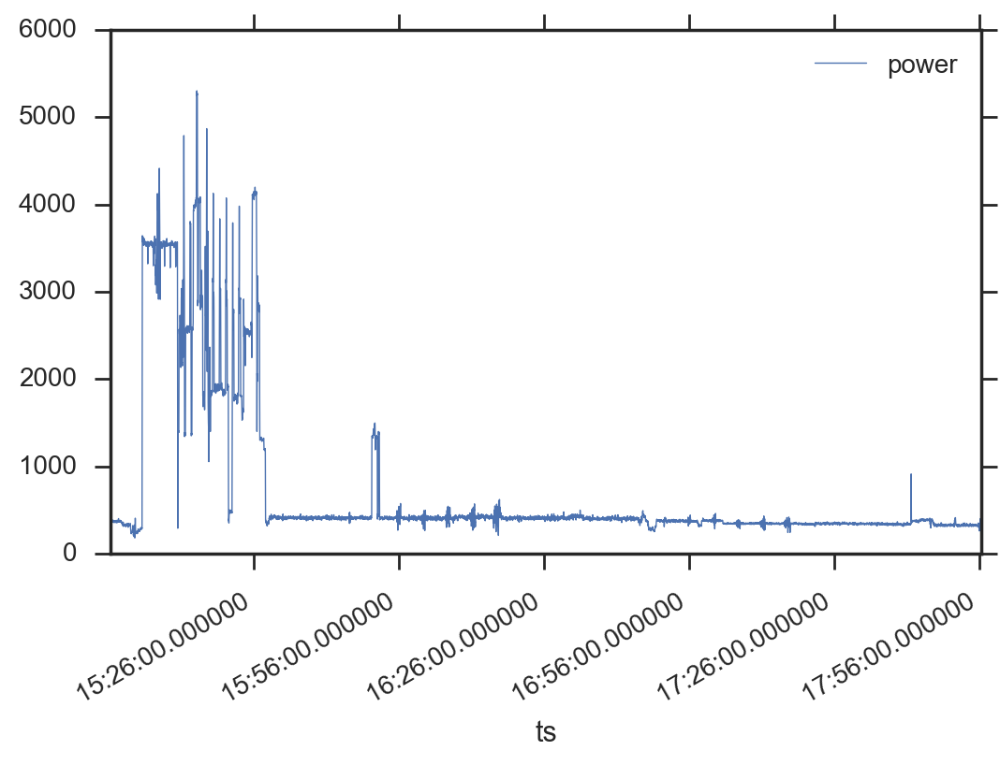

In [114]:
homog_power.loc[sub_data.index[-1]:sub_data.index[-1] + pd.Timedelta('3h')].plot(lw=.5)

PCA Explained variance ratio: [ 0.77121669  0.05281004] --> 0.8240267038345337
Estimated number of clusters: 36
Silhouette Coefficient: 0.666
                 4    33   1    16   6    25   19   28   31   7  ...  11  24  14  30  35  10  29  3   32  5 
Label members  2365  609  438  270  233  214  203  184  154  132 ...  40  40  28  26  25  25  21  21  18  16

[1 rows x 36 columns]
36
For n_clusters = 36 The average silhouette_score is : 0.228853


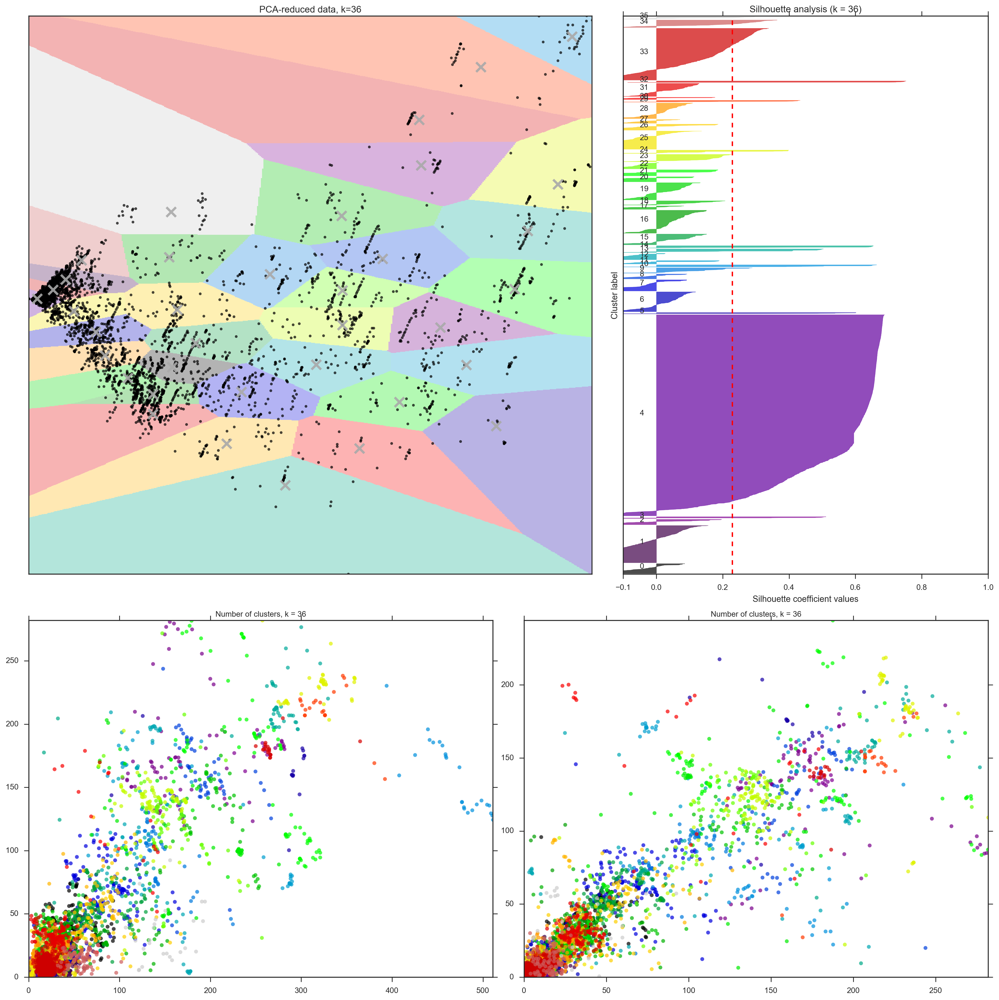

PLOT CLUSTERING TOOK: 24.993 s


In [116]:
k = 36
labels_pca, n_clusters_pca, model_pca, X_pca = pca_clustering(X, k, whiten=True, labels_true=None)
print(n_clusters_pca)

plot_clustering_figure(X, labels_pca, plot_clustering_as_voronoi, X_pca, model_pca)



In [ ]:

X = results_FFT.T.values
X_std = StandardScaler().fit_transform(X)

